# CAPSTONE PROJECT
This notebook will be used to complete the IBM Data Science Capstone Project

# 1. Importing packages

Not sure if I will be using all of these. The final line is not an import, simply setting pandas to show all columns of the dataframes when displaying

In [1]:
import pandas as pd
import numpy as np
import folium
from folium import plugins
from folium.features import GeoJsonPopup, GeoJsonTooltip
from geopy.geocoders import Nominatim
import json,requests
from pandas.io.json import json_normalize
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors
%matplotlib inline 
import matplotlib as mpl
import matplotlib.pyplot as plt
import re
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import seaborn as sns
from shapely.geometry import shape, Point
pd.set_option('display.max_columns',500)
pd.set_option('display.max_rows',500)
import warnings
warnings.filterwarnings('ignore')
#pd.reset_option('display.max_rows', silent=True)

# 2. Data Acquisition

### 2.1 Obtaining and visualizing neighborhoods
I will be looking at the neighborhoods of Philadelphia (Philly) by zip code. A geojson file (Zipcodes_Poly.geojson) containing geodata for each zip code in Philly was retrieved from [here](https://www.opendataphilly.org/dataset/zip-codes/resource/825cc9f5-92c2-4b7c-8b4e-6affa41396ee), licensed by the City of Philadelphia. To visaulize the borders, the geojson is used to create a choropleth map using the folium package

In [2]:
address = '1400 John F Kennedy Blvd, Philadelphia, PA 19107'

geolocator = Nominatim(user_agent="philly_explorer")
location = geolocator.geocode(address)
start_lat = location.latitude
start_long = location.longitude
print('The geograpical coordinate of {} are {}, {}.'.format(address,start_lat,start_long))

The geograpical coordinate of 1400 John F Kennedy Blvd, Philadelphia, PA 19107 are 39.9533709, -75.1634793.


In [3]:
philly_zips = r'Zipcodes_Poly.geojson'

m = folium.Map([start_lat,start_long],zoom_start = 11)

choropleth = folium.Choropleth(
    geo_data=philly_zips,
    name='Choropleth',
    fill_opacity=0.1,
    line_opacity=0.2,
    highlight=True,
    line_color='blue'
).add_to(m)

folium.LayerControl(collapsed=True).add_to(m)

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['CODE'],labels=False)
)
m


It would also be useful to have a dataframe containing the zip codes along with their respective locations. The zip codes can be retrieved easily enough from the geojson file, however; their location must be inferred. I choose to do this by averaging the points of each zip code from the geojson, creating a sort of geographical mean latitude and longitude. 

In [4]:
with open('Zipcodes_Poly.geojson') as json_file:
    data = json.load(json_file)

zipcodes = []

#retrieve zip codes and average [lat,long] per zip code
for zcode in data['features']:
    zipcode = zcode['properties']['CODE']
    temp = pd.DataFrame(zcode['geometry']['coordinates'][0])
    means = [temp[1].mean(),temp[0].mean()]
    zipcodes.append([zipcode]+means)

philly_df = pd.DataFrame(zipcodes,columns=['Zip Code','Latitude','Longitude'])
philly_df.sort_values(by='Zip Code',inplace=True)
philly_df.reset_index(inplace=True,drop=True)
philly_df.head()

,Zip Code,Latitude,Longitude
0,19102,39.952719,-75.165150
1,19103,39.954636,-75.175518
2,19104,39.958853,-75.196545
3,19106,39.952621,-75.147081
4,19107,39.952426,-75.159222


Let's do a quick sanity check of our inferred geographical mean by visualizing them as points on our Philly map. 

In [5]:
for label,lat,long in zip(philly_df['Zip Code'],philly_df['Latitude'],philly_df['Longitude']):
    folium.Marker(location = [lat,long],popup=label).add_to(m)
    
m   

### 2.2 Obtaining Venues for the neighborhoods
Using the foursquare API and the explore endpoint, we will obtain popular restaurants for each neighborhood. Below, we define some functions that will help us retreive a response from foursquare as well as retrieve our desired information from the response. 

In [6]:
CLIENT_ID = '#######################################' 
CLIENT_SECRET = '#######################################' 

def get_foursquare(ll,endpoint='explore',client_id=CLIENT_ID,
                   section=None,query='Food',
                   client_secret=CLIENT_SECRET,
                   v='20180605',limit=50,radius=None,sortByDistance=False):
    url = f'https://api.foursquare.com/v2/venues/{endpoint}'
    params = dict(
        client_id=client_id,
        client_secret=client_secret,
        v=v,
        ll=ll,
        query=query,
        limit=limit,
        radius = radius,
        sortByDistance=sortByDistance)
    
    resp = requests.get(url=url, params=params).json()
    return resp

def get_venues(zipcodes,lats,longs,**kwargs):
    rows = []
    for zipcode, lat, long in zip(zipcodes,lats,longs):
        print (zipcode,lat,long)
        ll = str(lat)+','+str(long)
        resp = get_foursquare(ll=ll,**kwargs)['response']['groups'][0]['items']
        if len(resp) != 0:
            for re in resp:
                venue_id = re['venue']['id']
                venue_name = re['venue']['name']
                lat = re['venue']['location']['lat']
                long = re['venue']['location']['lng']
                cat = re['venue']['categories'][0]['name']
                row = [zipcode,venue_id,venue_name,cat,lat,long]
                rows.append(row)
        else:
            row = [zipcode]
            rows.append(row)
    return rows

def get_coords(address):
    geolocator = Nominatim(user_agent="philly_explorer")
    location = geolocator.geocode(address)
    lat = location.latitude
    long = location.longitude
    return ([lat,long])

Now, we can use these functions to populate a dataframe containing popular restaurants. Note that we limit our search to venues relating to food by entering 'food' into the argument *query*. 

**NOTE** 
The response of the foursquare 'explore' endpoint is updated frequently as venues being considered popular changes. As the following sections of this notebook were very much dependent on this dataframe, the dataframe was saved and then loaded in. 

In [7]:
#philly_venues = get_venues(
#    zipcodes=philly_df['Zip Code'],
#    lats=philly_df['Latitude'],
#    longs=philly_df['Longitude'],
#    endpoint='explore',
#    query = 'food',
#    limit = 50)
    
#philly_venues_df = pd.DataFrame(philly_venues,columns=['Zip Code','Venue ID','Venue Name','Venue Category','Venue Lat','Venue Long'])
#philly_venues_df.drop_duplicates(subset = 'Venue ID',inplace=True)
#philly_venues_df.reset_index(inplace=True,drop=True)
#philly_venues_df

In [8]:
#philly_venues_df1 = philly_venues_df.loc[0:486]
#philly_venues_df2 = philly_venues_df.loc[487:972]
#philly_venues_df3 = philly_venues_df.loc[973:]

#philly_venues_df1.to_csv('philly_venues_df1.csv')
#philly_venues_df2.to_csv('philly_venues_df2.csv')
#philly_venues_df3.to_csv('philly_venues_df3.csv')

philly_venues_df1 = pd.read_csv('philly_venues_df1.csv')
philly_venues_df3 = pd.read_csv('philly_venues_df2.csv')
philly_venues_df2 = pd.read_csv('philly_venues_df3.csv')

philly_venues_df = pd.concat([philly_venues_df1,philly_venues_df2,philly_venues_df3],ignore_index=True)
philly_venues_df.drop('Unnamed: 0',inplace=True,axis=1)
philly_venues_df.sort_values(by='Zip Code',inplace=True)
philly_venues_df['Zip Code'] = philly_venues_df['Zip Code'].astype(str)

### 2.3 Obtaining detailed information about each venue

Now, we can finally switch over to the 'venue details' endpoint of foursquare. Unfortunately, this is a so called premium endpoint. Since I am not a member of premium caliber, I am limited to 500 premium calls a day. That is why I, in the previous cell, had to split up the dataframe into three dataframes containing less than 500 rows. Then, I passed one dataframe a day for three days until I had retrieved the information for the entire dataset. 

With that out of the way, I defined some extra functions to help us retrieve the detailed venue information. 

In [9]:
def get_tips(response_items):
    tips = []
    if len(response_items['response']['venue']['tips']['groups']) != 0:
        response_items = response_items['response']['venue']['tips']['groups'][0]['items']
        for item in response_items:
            tips.append(item['text'])
        return tips
    else:
        print (False)
    return

def get_price(response_items):
    try:
        return response_items['response']['venue']['price']['tier']
    except:
        return np.nan
    
def get_rating(response_items):
    try:
        return response_items['response']['venue']['rating']
    except:
        return np.nan

def get_attributes(response_items):
    try:
        attribute_dict={}
        for attribute in response_items['response']['venue']['attributes']['groups']:
            for att in attribute['items']:
                attribute_dict[att['displayName']] = att['displayValue']
                columns = attribute_dict.keys()
                values = attribute_dict.values()
        return columns,values,True
    except:
        return np.nan,np.nan,False

def get_delivery(response_items):
    try:
        return response_items['response']['venue']['delivery'] != None
    except:
        return False
    
def get_location(response_items):
    try:
        zipcode = response_items['response']['venue']['location']['postalCode']
        lat = response_items['response']['venue']['location']['lat']
        long = response_items['response']['venue']['location']['lng']
        return [zipcode,lat,long]
    except:
        return [np.nan,np.nan,np.nan]

The above functions can now be used to populate dataframes. Note that because of our 500 calls per day limit, I had to pass one dataframe of less than 500 rows per day until we had passed our entire philly_venues_df.

In [10]:

#DATAFRAME = philly_venues_df3
#venues_full_df3 = pd.DataFrame()

#responses=[]
#counter = 0
#for venue_id,venue_name in zip(DATAFRAME['Venue ID'],DATAFRAME['Venue Name']):
#    counter += 1
#    print (venue_id,f'Venues checked:{counter}')
#    response_items = get_foursquare(endpoint=venue_id,ll=None)
#    responses.append([venue_id,venue_name,response_items])
    
#    v_id = venue_id
#    name = venue_name
#    loc = get_location(response_items)
#    rating = get_rating(response_items)
#    price = get_price(response_items)
#    delivery = get_delivery(response_items)
#    cols,vals,has_atts = get_attributes(response_items)
#    tips = get_tips(response_items)
#    temp1 = pd.DataFrame([[v_id,name,rating,delivery,price,tips,loc]],
#                         columns=['ID','Name','Rating','Delivery','Price Tier','Tips','Location'])
#    if has_atts:
#        temp2 = pd.DataFrame([vals],columns = cols)
#        for col in cols:
#            if col in temp1.columns:
#                temp2.drop(col,axis=1,inplace=True)
                
#    temp3 = pd.concat((temp1,temp2),axis=1)
#    venues_full_df3 = venues_full_df3.append(temp3,ignore_index=True,sort=False)


Very important to save these dataframes! They could then be loaded in at anytime without me having to wait another 24h to make my 500 calls. 

In [11]:
#venues_full_df1.to_csv('venues_full_df1.csv')
#venues_full_df2.to_csv('venues_full_df2.csv')
#venues_full_df3.to_csv('venues_full_df3.csv')

venues_full_df1 = pd.read_csv('venues_full_df1.csv')
venues_full_df2 = pd.read_csv('venues_full_df2.csv')
venues_full_df3 = pd.read_csv('venues_full_df3.csv')

venues_full_df = pd.concat([venues_full_df1,venues_full_df2,venues_full_df3],ignore_index=True,sort=False)
venues_full_df

,Unnamed: 0,ID,Name,Rating,Delivery,Price Tier,Tips,Location,Price,Credit Cards,Outdoor Seating,Wi-Fi,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,Reservations,Brunch,Beer,Breakfast,Bar Service,Restroom,TVs,ATM,Private Room,Dessert,Music,Live Music,BYO,Street Parking,Public Lot,Wheelchair Accessible,Bar Snacks,Tasting Menu,Take-out,Private Lot,Coat Check,No,Parking,Jukebox,Table Service,Valet Parking
0,0,4ab2ac0bf964a520d66b20e3,Del Frisco's Double Eagle Steak House,8.7,True,4.0,"[""Over the top and that's what I love about it...","['19102', 39.9509564, -75.1654591]",$$$$,Yes (incl. Discover & Visa),No,Yes,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,4a281e64f964a520f4941fe3,Oyster House,9.3,False,3.0,['Miss the crowd by dining at Saturday brunch....,"['19102', 39.95041501026734, -75.16653292910065]",$$$,Yes (incl. American Express),No,NaN,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,No,Brunch,Beer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,56cc831ccd10c5927d30dc1d,Snap Custom Pizza,8.8,True,1.0,['The pizzas are all good. I like that they ar...,"['19102', 39.95041780860292, -75.16615225612854]",$,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,4af2d4cef964a520a9e821e3,The Capital Grille,8.5,False,4.0,"['Try the ""Sushi-Grade Seared Tuna With Ginger...","['19107', 39.95071559112756, -75.16394206082474]",$$$$,Yes (incl. Discover & Visa),No,Yes,NaN,Dinner,NaN,Wine,Full Bar,Cocktails,NaN,Brunch,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,4a4268fdf964a520d4a51fe3,Fogo De Chão,8.8,False,4.0,['Starve yourself before going here and then e...,"['19107', 39.9509166, -75.1629711]",$$$$,Yes (incl. Discover & Visa),No,Yes,Lunch,Dinner,NaN,Wine,NaN,Cocktails,Yes,NaN,Beer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,481,4b9fed58f964a520044b37e3,Syrenka Luncheonette,7.3,False,NaN,['Governments and neighborhoods change but gol...,"['19134', 39.982628999999996, -75.101703]",$,Yes (incl. American Express),Yes,Yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Breakfast,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1456,482,4c164e15a9c220a175655a9d,Best Deli,7.4,True,1.0,['Gotta love hot cooked breakfast (whtever u w...,"['19125', 39.979159920246616, -75.11530627302704]",$,Yes (incl. Discover & Visa),No,NaN,Lunch,Dinner,NaN,NaN,NaN,NaN,NaN,Brunch,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1457,483,4bd7323632a29521b002d6b8,SUBWAY,6.8,False,1.0,['Go to LA Fitness first and earn your $5 Foot...,"['19134', 39.99232320250646, -75.09982423029732]",$,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1458,484,50ba83cfe4b04809bdbdbb29,Eatalia BYOB,7.2,False,1.0,['You must try the lobster ravioli with cognac...,"['19125', 39.97497432861246, -75.1184394971756]",$,Yes (incl. Discover & Visa),No,Free,NaN,Dinner,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Dessert,NaN,NaN,BYO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Table Service,NaN


# 3. Data Wrangling

With all of our data contained in *venues_full_df*, we are now faced with the daunting task of wrangling, cleaning and cleansing our it.

### 3.1 Completing venues_full_df

We'll start slowly. It would also be useful to have the venue category in this dataframe, something I should have thought of earlier... Luckily, we have this information in the earlier created philly_venues_df. 

In [12]:
#venue_categories = philly_venues_df[['Venue ID','Venue Category']]
#venue_categories.columns = ['ID','Category']
#venues_full_df = venues_full_df.merge(venue_categories,on='ID')
temp_df = philly_venues_df.copy()
temp_df.drop(['Venue Name','Venue Lat','Venue Long','Zip Code'],axis=1,inplace=True)
temp_df.columns = ['ID','Category']
venues_full_df = venues_full_df.merge(temp_df,on='ID')
venues_full_df.head()

,Unnamed: 0,ID,Name,Rating,Delivery,Price Tier,Tips,Location,Price,Credit Cards,Outdoor Seating,Wi-Fi,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,Reservations,Brunch,Beer,Breakfast,Bar Service,Restroom,TVs,ATM,Private Room,Dessert,Music,Live Music,BYO,Street Parking,Public Lot,Wheelchair Accessible,Bar Snacks,Tasting Menu,Take-out,Private Lot,Coat Check,No,Parking,Jukebox,Table Service,Valet Parking,Category
0,0,4ab2ac0bf964a520d66b20e3,Del Frisco's Double Eagle Steak House,8.7,True,4.0,"[""Over the top and that's what I love about it...","['19102', 39.9509564, -75.1654591]",$$$$,Yes (incl. Discover & Visa),No,Yes,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Steakhouse
1,1,4a281e64f964a520f4941fe3,Oyster House,9.3,False,3.0,['Miss the crowd by dining at Saturday brunch....,"['19102', 39.95041501026734, -75.16653292910065]",$$$,Yes (incl. American Express),No,NaN,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,No,Brunch,Beer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Seafood Restaurant
2,2,56cc831ccd10c5927d30dc1d,Snap Custom Pizza,8.8,True,1.0,['The pizzas are all good. I like that they ar...,"['19102', 39.95041780860292, -75.16615225612854]",$,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pizza Place
3,3,4af2d4cef964a520a9e821e3,The Capital Grille,8.5,False,4.0,"['Try the ""Sushi-Grade Seared Tuna With Ginger...","['19107', 39.95071559112756, -75.16394206082474]",$$$$,Yes (incl. Discover & Visa),No,Yes,NaN,Dinner,NaN,Wine,Full Bar,Cocktails,NaN,Brunch,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,American Restaurant
4,4,4a4268fdf964a520d4a51fe3,Fogo De Chão,8.8,False,4.0,['Starve yourself before going here and then e...,"['19107', 39.9509166, -75.1629711]",$$$$,Yes (incl. Discover & Visa),No,Yes,Lunch,Dinner,NaN,Wine,NaN,Cocktails,Yes,NaN,Beer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Churrascaria


Next step: split the *Location* column into *Zip, Lat* and *Long*.

In [13]:
for index, row in venues_full_df.iterrows():
    location = row['Location'].strip("][").split(', ')
    location = [i.replace("'", "") for i in location]
    venues_full_df.at[index,'Zip'] = location[0]
    venues_full_df.at[index,'Lat'] = location[1]
    venues_full_df.at[index,'Long'] = location[2]

venues_full_df.head()

,Unnamed: 0,ID,Name,Rating,Delivery,Price Tier,Tips,Location,Price,Credit Cards,Outdoor Seating,Wi-Fi,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,Reservations,Brunch,Beer,Breakfast,Bar Service,Restroom,TVs,ATM,Private Room,Dessert,Music,Live Music,BYO,Street Parking,Public Lot,Wheelchair Accessible,Bar Snacks,Tasting Menu,Take-out,Private Lot,Coat Check,No,Parking,Jukebox,Table Service,Valet Parking,Category,Zip,Lat,Long
0,0,4ab2ac0bf964a520d66b20e3,Del Frisco's Double Eagle Steak House,8.7,True,4.0,"[""Over the top and that's what I love about it...","['19102', 39.9509564, -75.1654591]",$$$$,Yes (incl. Discover & Visa),No,Yes,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Steakhouse,19102,39.9509564,-75.1654591
1,1,4a281e64f964a520f4941fe3,Oyster House,9.3,False,3.0,['Miss the crowd by dining at Saturday brunch....,"['19102', 39.95041501026734, -75.16653292910065]",$$$,Yes (incl. American Express),No,NaN,Lunch,Dinner,Happy Hour,Wine,Full Bar,Cocktails,No,Brunch,Beer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Seafood Restaurant,19102,39.95041501026734,-75.16653292910065
2,2,56cc831ccd10c5927d30dc1d,Snap Custom Pizza,8.8,True,1.0,['The pizzas are all good. I like that they ar...,"['19102', 39.95041780860292, -75.16615225612854]",$,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Pizza Place,19102,39.95041780860292,-75.16615225612854
3,3,4af2d4cef964a520a9e821e3,The Capital Grille,8.5,False,4.0,"['Try the ""Sushi-Grade Seared Tuna With Ginger...","['19107', 39.95071559112756, -75.16394206082474]",$$$$,Yes (incl. Discover & Visa),No,Yes,NaN,Dinner,NaN,Wine,Full Bar,Cocktails,NaN,Brunch,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,American Restaurant,19107,39.95071559112756,-75.16394206082474
4,4,4a4268fdf964a520d4a51fe3,Fogo De Chão,8.8,False,4.0,['Starve yourself before going here and then e...,"['19107', 39.9509166, -75.1629711]",$$$$,Yes (incl. Discover & Visa),No,Yes,Lunch,Dinner,NaN,Wine,NaN,Cocktails,Yes,NaN,Beer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Churrascaria,19107,39.9509166,-75.1629711


### 3.2 Dropping columns and reordering
Several columns are redundant or uneccessary, let's drop these before moving forward to save memory and time. We'll also reorder the columns in a way that makes sense and is practical for indexing. 

In [14]:
venues_full_df.drop('Unnamed: 0',axis=1,inplace=True) #redundant due to index column
venues_full_df.drop('No',axis=1,inplace=True) #don't even know what this is
venues_full_df.drop('Price',axis=1,inplace=True) #redundant due to price tier
venues_full_df.drop('Location',axis=1,inplace=True) #redundant due to zip,lat,long columns
venues_full_df.drop('Tips',axis=1,inplace=True) #don't think we'll be using this, but we can always get it back later should we change our mind

columns_order = ['ID', 'Name', 'Zip', 'Lat', 'Long', 'Category', 'Rating', 'Price Tier', 
                 'Delivery', 'Credit Cards', 'Outdoor Seating', 'Wi-Fi',
                 'Breakfast', 'Brunch', 'Lunch', 'Dinner', 'Reservations', 
                 'Happy Hour', 'Wine', 'Full Bar', 'Cocktails', 'Beer', 'Bar Service', 
                 'Dessert', 'Private Room', 'Restroom', 'Live Music', 'BYO', 'Music', 
                 'Wheelchair Accessible', 'Take-out', 'Street Parking', 'Bar Snacks', 
                 'Tasting Menu', 'Private Lot', 'Coat Check', 'ATM', 'TVs', 'Parking', 
                 'Public Lot', 'Table Service', 'Jukebox', 'Valet Parking']
venues_full_df = venues_full_df[columns_order]
venues_full_df.head()

,ID,Name,Zip,Lat,Long,Category,Rating,Price Tier,Delivery,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Wine,Full Bar,Cocktails,Beer,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking
0,4ab2ac0bf964a520d66b20e3,Del Frisco's Double Eagle Steak House,19102,39.9509564,-75.1654591,Steakhouse,8.7,4.0,True,Yes (incl. Discover & Visa),No,Yes,NaN,NaN,Lunch,Dinner,NaN,Happy Hour,Wine,Full Bar,Cocktails,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4a281e64f964a520f4941fe3,Oyster House,19102,39.95041501026734,-75.16653292910065,Seafood Restaurant,9.3,3.0,False,Yes (incl. American Express),No,NaN,NaN,Brunch,Lunch,Dinner,No,Happy Hour,Wine,Full Bar,Cocktails,Beer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,56cc831ccd10c5927d30dc1d,Snap Custom Pizza,19102,39.95041780860292,-75.16615225612854,Pizza Place,8.8,1.0,True,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4af2d4cef964a520a9e821e3,The Capital Grille,19107,39.95071559112756,-75.16394206082474,American Restaurant,8.5,4.0,False,Yes (incl. Discover & Visa),No,Yes,NaN,Brunch,NaN,Dinner,NaN,NaN,Wine,Full Bar,Cocktails,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4a4268fdf964a520d4a51fe3,Fogo De Chão,19107,39.9509166,-75.1629711,Churrascaria,8.8,4.0,False,Yes (incl. Discover & Visa),No,Yes,NaN,NaN,Lunch,Dinner,Yes,NaN,Wine,NaN,Cocktails,Beer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 3.2 Missing values
Because of the way I wrote my functions, I'm expecting missing values in columns other than the first eight. So let's make sure there are none here. 

In [15]:
total = venues_full_df.iloc[:,0:8].isnull().sum().sort_values(ascending=False)
percent = venues_full_df.iloc[:,0:8].isnull().sum()/venues_full_df.shape[0]
nulls_df = pd.concat([total,percent],axis=1,sort=False,keys=['Null Count',f'% (/{venues_full_df.shape[0]})'])
nulls_df

,Null Count,% (/1460)
Rating,101,0.069178
Price Tier,33,0.022603
Category,0,0.000000
Long,0,0.000000
Lat,0,0.000000
Zip,0,0.000000
Name,0,0.000000
ID,0,0.000000


Aha, some missing values where they shouldn't be! Since it's just a small amount we'll impute the missing rating values with the mean rating and drop the 33 rows that are missing their price tier. 

In [16]:
venues_full_df.dropna(subset=['Price Tier'],inplace=True)
venues_full_df['Rating'].fillna(venues_full_df['Rating'].mean(),inplace=True)

There are however more missing values than the above shows. Because of the way the location data was stored, null values were read as 'nan', as in a string saying nan. Take a look. 

In [17]:
venues_full_df[venues_full_df['Zip'] == 'nan'].head() 

,ID,Name,Zip,Lat,Long,Category,Rating,Price Tier,Delivery,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Wine,Full Bar,Cocktails,Beer,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking
42,578fa4bc498e67c587418b95,Real Food Eatery,nan,nan,nan,New American Restaurant,8.3,4.0,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
45,56631bb1498ec93dd2faa462,The Rothman Cabin,nan,nan,nan,Café,7.5,1.0,False,NaN,NaN,NaN,NaN,NaN,NaN,Dinner,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
89,51ca12c4498e023ee736154a,Cinnabon,nan,nan,nan,Bakery,6.4,1.0,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
90,515c8455e4b03192daae6e26,Nathan's Famous,nan,nan,nan,Hot Dog Joint,6.3,1.0,True,Yes,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
122,4bb61dd42f70c9b6eae48430,MexiCali Truck,nan,nan,nan,Food Truck,7.8,1.0,False,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


I also noticed some strange zip codes that are do not exist in the official list of zip codes for Philly. The restaurant must have inputted the information strangely. Alternatively, the foursquare *explore* endpoint may have checked outside the boarders of the Philadelphia. 

In [18]:
not_zip = []
for zipcode in venues_full_df['Zip'].unique():
    if zipcode not in philly_df['Zip Code'].values:
        not_zip.append(zipcode)
not_zip

['19102-2522',
 'nan',
 '19012',
 '19006',
 '19046',
 '19027',
 '19020',
 '08075',
 '19136-1314',
 '19053',
 '08691',
 '19444',
 '19095',
 '19082',
 '19050',
 '19023',
 '19013',
 '19026',
 '19096',
 '19083',
 '19079',
 '19029',
 '19038',
 '08540',
 '19004']

For the majority of these restaurants, we also failed to retrieve coordinates. So, we'll have to retrieve these from *philly_venues_df*. Then, we'll infer the zipcode by checking which area the venues' coordinates exist inside of. This will be achieved by using a handy package called shapely and the geodata we used to construct the choropleth map (see *check_point* function below)

In [19]:
not_zipID = venues_full_df.loc[venues_full_df['Zip'].isin(not_zip)]['ID']
nan_locs = philly_venues_df.loc[philly_venues_df['Venue ID'].isin(not_zipID)]

In [20]:
def check_point(lat,long,data):
    point = Point(long,lat)
    for feature in data['features']:
        polygon = shape(feature['geometry'])
        if polygon.contains(point):
            return feature['properties']['CODE']

with open('Zipcodes_Poly.geojson') as json_file:
    data = json.load(json_file)
    
for index,row in venues_full_df[venues_full_df['ID'].isin(nan_locs['Venue ID'])].iterrows():
    lat = nan_locs.loc[nan_locs['Venue ID'] == row['ID']]['Venue Lat'].values[0]
    long = nan_locs.loc[nan_locs['Venue ID'] == row['ID']]['Venue Long'].values[0]
    zipcode = check_point(lat,long,data)
    
    venues_full_df.at[index,'Lat'] = nan_locs.loc[nan_locs['Venue ID'] == row['ID']]['Venue Lat'].values[0]
    venues_full_df.at[index,'Long'] = nan_locs.loc[nan_locs['Venue ID'] == row['ID']]['Venue Long'].values[0]
    venues_full_df.at[index,'Zip'] = zipcode

The zip codes that do not belong to the city of Philadelphia would have gotten the null values, so lets quickly drop those. 

In [21]:
venues_full_df.dropna(subset=['Zip'],inplace=True)

Now, let's visually verify that everything has turned out as expected for our corrected venues. 

In [22]:
m2 = folium.Map([start_lat,start_long],zoom_start = 11)

choropleth = folium.Choropleth(
    geo_data=philly_zips,
    name='Choropleth',
    fill_opacity=0.1,
    line_opacity=0.2,
    highlight=True,
    line_color='blue'
).add_to(m2)

folium.LayerControl(collapsed=True).add_to(m2)

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['CODE'],labels=False)
)


temp = venues_full_df[venues_full_df['ID'].isin(not_zipID)]

for label1,label2,lat,long in zip(temp['Name'],temp['Zip'],temp['Lat'],temp['Long']):
    folium.Marker(location = [lat,long],popup=(label1,label2)).add_to(m2)

m2

### 3.3 Transformation

Most of our variables are nominal. So we need to transform the values to 1/0. To perform the transformation, let's see what values the variables can take.

In [23]:
for col in venues_full_df.columns[8:]:
    print (col,'\n',venues_full_df[col].value_counts(),'\n************')

Delivery 
 False    734
True     549
Name: Delivery, dtype: int64 
************
Credit Cards 
 Yes                                            264
Yes (incl. Discover & Visa)                    168
Yes (incl. American Express)                   135
No                                             101
Yes (incl. American Express & MasterCard)       41
Yes (incl. Visa & MasterCard)                   27
Yes (incl. Discover & MasterCard)               13
Yes (incl. Visa)                                 5
Yes (incl. NFC Payments & American Express)      4
Yes (incl. MasterCard & American Express)        2
Yes (incl. MasterCard)                           2
Yes (incl. Diners Club & American Express)       2
Yes (incl. Discover & American Express)          2
Yes (incl. Visa & American Express)              2
Yes (incl. NFC Payments & MasterCard)            1
Yes (incl. Diners Club & Visa)                   1
Yes (incl. Discover)                             1
Yes (incl. NFC Payments)              

So, for some variables we have to transform True or Yes -> 1; False or No -> 0. For some variables, a True value is indicated by the variable name itself (see the last 10 columns). The columns *Wifi, Street Parking* and *Valet Parking* need some special attention as well.

In [24]:
iter_cols = venues_full_df.iloc[:,8:].columns
for index,row in venues_full_df.iloc[:,8:].iterrows():
    for i,val in enumerate(row):
        if val == iter_cols[i]:
            venues_full_df.at[index,iter_cols[i]] = 1
            
venues_full_df.iloc[:,8:] = venues_full_df.iloc[:,8:].replace([r'^Yes',r'^No'],[1,0],regex=True)
venues_full_df.iloc[:,8:] = venues_full_df.iloc[:,8:].replace([True,False],[1,0])            
venues_full_df.loc[:,'Wi-Fi'] = venues_full_df.loc[:,'Wi-Fi'].replace('Free',1)
venues_full_df.loc[:,'Street Parking'] = venues_full_df.loc[:,'Street Parking'].replace('Street',1)
venues_full_df.loc[:,'Valet Parking'] = venues_full_df.loc[:,'Valet Parking'].replace('Valet',1)
venues_full_df.fillna(value=0,inplace=True)

In [25]:
for col in venues_full_df.columns[8:]:
    print (col,'\n',venues_full_df[col].value_counts(),'\n************')

Delivery 
 0    734
1    549
Name: Delivery, dtype: int64 
************
Credit Cards 
 1.0    671
0.0    612
Name: Credit Cards, dtype: int64 
************
Outdoor Seating 
 0.0    1056
1.0     227
Name: Outdoor Seating, dtype: int64 
************
Wi-Fi 
 0.0    1124
1.0     159
Name: Wi-Fi, dtype: int64 
************
Breakfast 
 0.0    1051
1.0     232
Name: Breakfast, dtype: int64 
************
Brunch 
 0.0    913
1.0    370
Name: Brunch, dtype: int64 
************
Lunch 
 0.0    848
1.0    435
Name: Lunch, dtype: int64 
************
Dinner 
 0.0    874
1.0    409
Name: Dinner, dtype: int64 
************
Reservations 
 0.0    1147
1.0     136
Name: Reservations, dtype: int64 
************
Happy Hour 
 0.0    1161
1.0     122
Name: Happy Hour, dtype: int64 
************
Wine 
 0.0    1208
1.0      75
Name: Wine, dtype: int64 
************
Full Bar 
 0.0    1119
1.0     164
Name: Full Bar, dtype: int64 
************
Cocktails 
 0.0    1105
1.0     178
Name: Cocktails, dtype: int64 
***

Finally, the pandas get_dummies function made quick work of the category variable.

In [26]:
#cols = list(venues_full_df.columns)
#venues_full_df = venues_full_df[cols[0:7]+cols[8:]+[cols[7]]]

cat_dum = pd.get_dummies(venues_full_df['Category'])
venues_full_df = pd.concat([venues_full_df,cat_dum],axis=1)
#venues_full_df.drop('Category',axis=1,inplace=True)
venues_full_df.head()

,ID,Name,Zip,Lat,Long,Category,Rating,Price Tier,Delivery,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Wine,Full Bar,Cocktails,Beer,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking,African Restaurant,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bistro,Brazilian Restaurant,Breakfast Spot,Burger Joint,Burmese Restaurant,Burrito Place,Cafeteria,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Churrascaria,Comfort Food Restaurant,Creperie,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Food,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Indonesian Restaurant,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mac & Cheese Joint,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,New American Restaurant,Noodle House,Paella Restaurant,Peruvian Restaurant,Pizza Place,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint
0,4ab2ac0bf964a520d66b20e3,Del Frisco's Double Eagle Steak House,19102,39.9509564,-75.1654591,Steakhouse,8.7,4.0,1,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,4a281e64f964a520f4941fe3,Oyster House,19102,39.95041501026734,-75.16653292910065,Seafood Restaurant,9.3,3.0,0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,56cc831ccd10c5927d30dc1d,Snap Custom Pizza,19102,39.95041780860292,-75.16615225612854,Pizza Place,8.8,1.0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,4af2d4cef964a520a9e821e3,The Capital Grille,19107,39.95071559112756,-75.16394206082474,American Restaurant,8.5,4.0,0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,4a4268fdf964a520d4a51fe3,Fogo De Chão,19107,39.9509166,-75.1629711,Churrascaria,8.8,4.0,0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


# Sidetrack - Get more venues

As I was starting my visualization of the data, I quickly noticed that some imbalance in the number of venues per zip code. Of course, this was expected but I also know that because of the way the foursquare *explore* endpoint works, our data may be a little unfair to some zip codes. Thus I began my short sidetrack to retrieve a few more venues for the most affected zip codes. 

I decided to make the cutoff at zip codes that have less than 20 venues (ignore the dataframe name...). This time when retrieving venues, we'll set the foursquare argument *sortByDistance* to true, which will prioritize venues closer to the epicenter of the zip area and reduce the chance of selecting venues outside the zip area. We'll retrive 30 venues because this puts the total size of the dataframe just below 500 venues, which as you'll recall is the maximum number of calls I can make to the enpoint *venue details*.

In [27]:
venues_full_df.groupby(by='Zip').count().sort_values(by='ID')

,ID,Name,Lat,Long,Category,Rating,Price Tier,Delivery,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Wine,Full Bar,Cocktails,Beer,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking,African Restaurant,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bistro,Brazilian Restaurant,Breakfast Spot,Burger Joint,Burmese Restaurant,Burrito Place,Cafeteria,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Churrascaria,Comfort Food Restaurant,Creperie,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Food,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Indonesian Restaurant,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mac & Cheese Joint,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,New American Restaurant,Noodle House,Paella Restaurant,Peruvian Restaurant,Pizza Place,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint
Zip,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
19112,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
19126,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4
19137,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7,7
19133,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9
19139,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10
19121,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10
19150,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12
19116,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,1

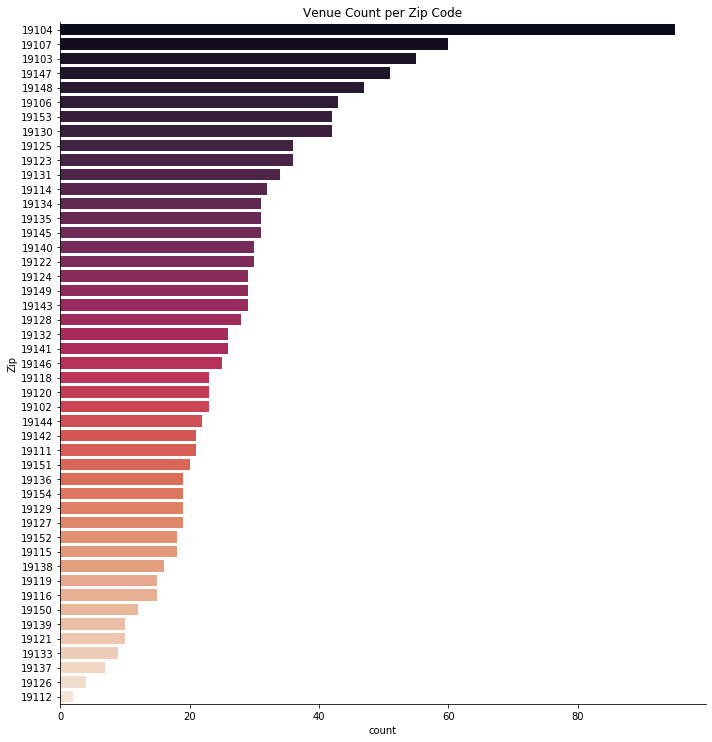

In [28]:
ax = sns.catplot(y='Zip',data=venues_full_df, kind='count',orient="h",palette='rocket',
            order=venues_full_df['Zip'].value_counts().index,height=10,aspect=1)
plt.title('Venue Count per Zip Code')
plt.show()

In [29]:
#less10_df = venues_full_df.groupby(by='Zip').count().sort_values(by='ID')
#less10_df = less10_df.loc[less10_df['ID']<=20]
#less10_df = philly_df[philly_df['Zip Code'].isin(less10_df.index)]


#extra = get_venues(
#    zipcodes=less10_df['Zip Code'],
#    lats=less10_df['Latitude'],
#    longs=less10_df['Longitude'],
#    endpoint='explore',
#    query = 'food',
#    sortByDistance = True,
#    limit = 30)

#extra_df = pd.DataFrame(extra,columns=['Zip','ID','Name','Category','Lat','Long'])
#extra_df.drop_duplicates(subset = 'ID',inplace=True)
#extra_df.reset_index(inplace=True,drop=True)
#extra_df

In [30]:
#extra_df.to_csv('extra_df.csv')
extra_df = pd.read_csv('extra_df.csv')
extra_df['Zip'] = extra_df['Zip'].astype(str)
extra_df.drop('Unnamed: 0',inplace=True,axis=1)

extra_df.groupby(by='Zip').count().sort_values(by='ID')

,ID,Name,Category,Lat,Long
Zip,,,,,
19150,17,17,17,17,17
19138,21,21,21,21,21
19152,22,22,22,22,22
19129,27,27,27,27,27
19151,28,28,28,28,28
19112,30,30,30,30,30
19139,30,30,30,30,30
19137,30,30,30,30,30
19136,30,30,30,30,30


That's looking good, we successfully retrieved 30 venues for most of our zip codes. Some, such as 19150 probably just doesn't have a lot of restaurants. 

Now, we need to get the detailed information. I'm just going to reuse the code from before, with some slight alteration given what we've learned about the location data. 

In [31]:
#DATAFRAME = extra_df
#extra_full_df = pd.DataFrame()

#responses=[]
#counter = 0
#for v_id,v_name,v_zip,v_lat,v_long in zip(DATAFRAME['ID'],DATAFRAME['Name'],
#                                          DATAFRAME['Zip'],DATAFRAME['Lat'],DATAFRAME['Long']):
#    counter += 1
#    print (v_id,f'Venues checked:{counter}/{len(DATAFRAME)}')
#    response_items = get_foursquare(endpoint=v_id,ll=None)
#    responses.append([v_id,v_name,response_items])
#    
#    #loc = get_location(response_items)
#    rating = get_rating(response_items)
#    price = get_price(response_items)
#    delivery = get_delivery(response_items)
#    cols,vals,has_atts = get_attributes(response_items)
    #tips = get_tips(response_items)
#    temp1 = pd.DataFrame([[v_id,v_name,v_zip,v_lat,v_long,rating,delivery,price]],
#                         columns=['ID','Name','Zip','Lat','Long','Rating','Delivery','Price Tier'])
#    if has_atts:
#        temp2 = pd.DataFrame([vals],columns = cols)
#        for col in cols:
#            if col in temp1.columns:
#                temp2.drop(col,axis=1,inplace=True)
#                
#    temp3 = pd.concat((temp1,temp2),axis=1)
#    extra_full_df = extra_full_df.append(temp3,ignore_index=True,sort=False)


In [32]:
#extra_full_df.to_csv('extra_full_df.csv')
extra_full_df = pd.read_csv('extra_full_df.csv')
extra_full_df['Zip'] = extra_full_df['Zip'].astype(str)
extra_full_df.groupby(by='Zip').count().sort_values(by='ID')


,Unnamed: 0,ID,Name,Lat,Long,Rating,Delivery,Price Tier,Price,Credit Cards,Outdoor Seating,Reservations,Brunch,Dinner,Lunch,Beer,Breakfast,Music,Happy Hour,Full Bar,Cocktails,Dessert,Wi-Fi,Wine,Jukebox,Public Lot,Restroom,Wheelchair Accessible,TVs,No,BYO,Take-out,Street Parking,Private Lot,Live Music,Valet Parking,Private Room,ATM,Tasting Menu
Zip,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
19150,17,17,17,17,17,17,17,17,17,6,8,4,5,6,7,0,6,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
19138,21,21,21,21,21,14,21,21,21,11,12,11,2,0,3,0,10,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19152,22,22,22,22,22,12,22,22,22,4,6,5,2,3,2,0,2,0,0,0,1,0,1,0,1,1,1,1,0,1,1,1,1,0,0,0,0,0,0
19129,27,27,27,27,27,24,27,27,27,18,17,10,7,6,7,1,6,1,2,3,1,1,4,1,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0
19151,28,28,28,28,28,16,28,28,28,11,10,5,1,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19112,30,30,30,30,30,29,30,30,30,17,18,8,6,5,5,2,6,1,1,2,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19139,30,30,30,30,30,17,30,30,30,11,16,15,3,1,1,0,8,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
19137,30,30,30,30,30,28,30,30,30,14,20,8,9,8,9,0,5,0,0,0,1,1,6,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
19136,30,30,30,30,30,23,30,30,30,20,23,12,6,7,9,2,7,0,2,3,3,2,3,0,0,0,1,0,0,2,2,0,2,0,0,0,1,0,0


Now we just have to go through the same cleaning process as earlier and concatenate with *venues_full_df*

In [33]:
temp_df = extra_df.copy()
temp_df.drop(['Name','Lat','Long','Zip'],axis=1,inplace=True)
temp_df.columns = ['ID','Category']
extra_full_df = extra_full_df.merge(temp_df,on='ID')

extra_full_df.drop('Unnamed: 0',axis=1,inplace=True) #redundant due to price tier
extra_full_df.drop('No',axis=1,inplace=True) #don't even know what this is
extra_full_df.drop('Price',axis=1,inplace=True) #redundant due to price tier

columns_order = ['ID', 'Name', 'Zip', 'Lat', 'Long', 'Category', 'Rating', 'Price Tier', 
                 'Delivery', 'Credit Cards', 'Outdoor Seating', 'Wi-Fi',
                 'Breakfast', 'Brunch', 'Lunch', 'Dinner', 'Reservations', 
                 'Happy Hour', 'Wine', 'Full Bar', 'Cocktails', 'Beer',
                 'Dessert', 'Private Room', 'Restroom', 'Live Music', 'BYO', 
                 'Music', 'Wheelchair Accessible', 'Take-out', 'Street Parking', 
                 'Tasting Menu', 'Private Lot', 'ATM', 'TVs','Public Lot', 'Jukebox', 'Valet Parking']
extra_full_df = extra_full_df[columns_order]

extra_full_df.dropna(subset=['Price Tier'],inplace=True)
extra_full_df['Rating'].fillna(extra_full_df['Rating'].mean(),inplace=True)

iter_cols = extra_full_df.iloc[:,8:].columns
for index,row in extra_full_df.iloc[:,8:].iterrows():
    for i,val in enumerate(row):
        if val == iter_cols[i]:
            extra_full_df.at[index,iter_cols[i]] = 1
            
extra_full_df.iloc[:,8:] = extra_full_df.iloc[:,8:].replace([r'^Yes',r'^No'],[1,0],regex=True)
extra_full_df.iloc[:,8:] = extra_full_df.iloc[:,8:].replace([True,False],[1,0])            
extra_full_df.loc[:,'Wi-Fi'] = extra_full_df.loc[:,'Wi-Fi'].replace('Free',1)
extra_full_df.loc[:,'Street Parking'] = extra_full_df.loc[:,'Street Parking'].replace('Street',1)
extra_full_df.loc[:,'Valet Parking'] = extra_full_df.loc[:,'Valet Parking'].replace('Valet',1)
extra_full_df.fillna(value=0,inplace=True)
cols = list(extra_full_df.columns)
extra_full_df = extra_full_df[cols[0:7]+cols[8:]+[cols[7]]]

for index,row in extra_full_df.iterrows():
    lat = row['Lat']
    long = row['Long']
    zipcode = check_point(lat,long,data)
    extra_full_df.at[index,'Zip'] = zipcode

cat_dum = pd.get_dummies(extra_full_df['Category'])
extra_full_df = pd.concat([extra_full_df,cat_dum],axis=1)
#extra_full_df.drop('Category',axis=1,inplace=True)
extra_full_df.dropna(subset=['Zip'],axis=0,inplace=True)
extra_full_df.head()

,ID,Name,Zip,Lat,Long,Category,Rating,Delivery,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Wine,Full Bar,Cocktails,Beer,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Tasting Menu,Private Lot,ATM,TVs,Public Lot,Jukebox,Valet Parking,Price Tier,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Brazilian Restaurant,Breakfast Spot,Burger Joint,Café,Caribbean Restaurant,Chinese Restaurant,Deli / Bodega,Diner,Donut Shop,Eastern European Restaurant,Fast Food Restaurant,Food Truck,French Restaurant,Fried Chicken Joint,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Moroccan Restaurant,New American Restaurant,Pizza Place,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Southern / Soul Food Restaurant,Spanish Restaurant,Sushi Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint
0,59666a2164c8e166fd70c996,Bar Amis,19112,39.896625,-75.175513,Italian Restaurant,8.5,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,5812976e38fabbd0109df490,Shake Shack,19148,39.901250,-75.171985,Burger Joint,7.5,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,5126439be8895a09e35c4290,Tony Luke's,19148,39.901309,-75.172019,Sandwich Place,7.2,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,4bc209d874a9a5933f9cd2f6,Chickie's & Pete's,19148,39.901196,-75.171857,Fast Food Restaurant,6.8,0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,4b5c5724f964a520a02b29e3,Cadillac Grille,19148,39.901725,-75.172125,Restaurant,6.9,0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [34]:
venues_full_df = pd.concat([venues_full_df,extra_full_df],axis=0,ignore_index=True,sort=False)
venues_full_df.drop_duplicates(subset=['ID'],inplace=True)
print (f'Added {venues_full_df.shape[0]-1283} new rows')

Added 110 new rows


Null values are expected since we're concatinating rows which may not have values for all the columns in *venues_full_df*. Since we're adding 110 new rows, we should see alot variables with 110 null values. In the case that we're adding new variables, we should see alot more. If everything looks like expected, we'll simply fill these null values with 0 as before. 

In [35]:
total = venues_full_df.isnull().sum().sort_values(ascending=False)
total = total[total>0]
percent = venues_full_df.isnull().sum()/venues_full_df.shape[0]
percent = percent[percent>0]
nulls_df = pd.concat([total,percent],axis=1,sort=False,keys=['Null Count',f'% (/{venues_full_df.shape[0]})'])
nulls_df

,Null Count,% (/1393)
Moroccan Restaurant,1283,0.921034
Dim Sum Restaurant,110,0.078966
Bar Service,110,0.078966
Israeli Restaurant,110,0.078966
Indonesian Restaurant,110,0.078966
Gluten-free Restaurant,110,0.078966
German Restaurant,110,0.078966
Gastropub,110,0.078966
Food,110,0.078966
Falafel Restaurant,110,0.078966


In [36]:
venues_full_df.fillna(0,inplace=True)

It may also be interesting to look at how the restaurants change depending on distance from the city center. Philly's undisputed center is city hall, so we'll calculate distance from the restaurant to this point.

In [37]:
import math
cityhall = [39.952384, -75.163609]


for index,row in venues_full_df.iterrows():
    tlat = float(row['Lat'])
    tlong = float(row['Long'])
    dist = math.hypot(tlat-cityhall[0],tlong-cityhall[1])
    venues_full_df.at[index,'Dist'] = dist

venues_full_df.insert(6,'Distance',venues_full_df['Dist'])
venues_full_df.drop('Dist',1,inplace=True)

# 4 Data Visualization
In this section, we will visualize our data in two parts. First, we look at our dataset where each row is a venue. In the second part, a dataset grouped by zip code will be visualized. 

### 4.1 Venue Data

To begin this stage of exploring our data, the venues were visualized as marker clusters on a map of Philly with boarders of the zip codes.  

In [38]:
from folium import plugins

m2 = folium.Map([start_lat,start_long],zoom_start = 11)

cluster_markers_fg = folium.FeatureGroup(name='Restaurants clusters')

venues = plugins.MarkerCluster()

# loop through the dataframe and add each data point to the mark cluster
for lt, lng, label1,label2, in zip(venues_full_df['Lat'], venues_full_df['Long'], 
                                   venues_full_df['Name'],venues_full_df['Zip']):
    folium.Marker(
        location=[lt, lng],
        popup=(label1,label2),
    ).add_to(venues)
    
venues.add_to(cluster_markers_fg)

choropleth = folium.Choropleth(
    geo_data=philly_zips,
    name='Choropleth',
    fill_opacity=0.1,
    line_opacity=0.5,
    highlight=True,
    line_color='blue'
).add_to(m2)

cluster_markers_fg.add_to(m2)

folium.LayerControl(collapsed=True).add_to(m2)

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['CODE'],labels=False)
)



m2

Because it was an aspiration to obtain a balanced number of venues across zip codes, we cannot observe a perhaps expected dissipation of restaurants as we move further away from the city center. At default zoom level, the center appears to have a higher concentration of venues, but this merely owes to the fact taht the zip codes are smaller toward the center of the city.  

Next, a correlation matrix was plotted to explore potential correlations between the varaibles that may stand out. 

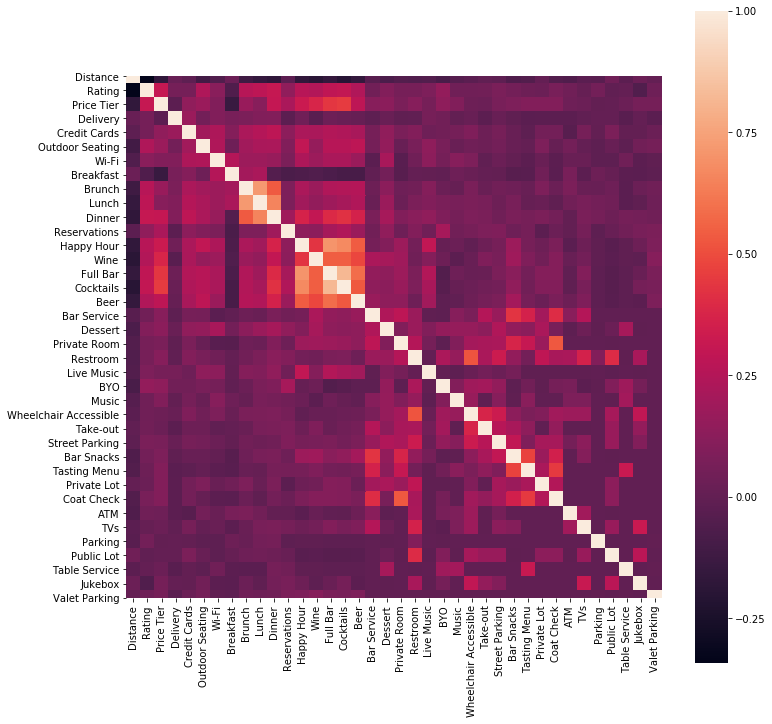

In [39]:
corrmat = venues_full_df.corr()
f, ax = plt.subplots(figsize=(12, 12))
sns.heatmap(corrmat.iloc[:38,:38], square=True);

Nothing appears to be particularly noteworthy, save for the correlation between the various alhocol types and the variables brunch and lunch. Because of the strong correlation between the forms of alcohol, a new ordinal variable, *Alcohol*, was created whose value is 1 if the venue has any of the alcohol forms. 

In [40]:
alcohol = venues_full_df[['Cocktails','Beer','Wine','Full Bar']].any(1)
venues_full_df.insert(10,'Alcohol',alcohol.astype(int))
venues_full_df.drop(['Cocktails','Beer','Wine','Full Bar'],1,inplace=True)

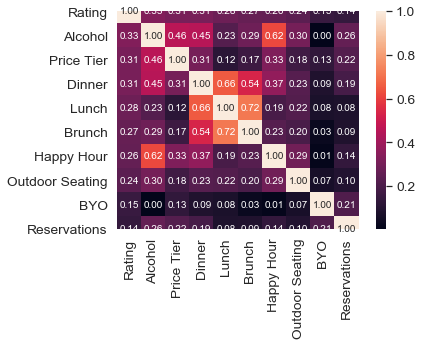

In [41]:
corrmat = venues_full_df.corr()
#saleprice correlation matrix
k = 10 #number of variables for heatmap
cols = corrmat.nlargest(k, 'Rating')['Rating'].index
corrmat2 = np.corrcoef(venues_full_df[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(corrmat2, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

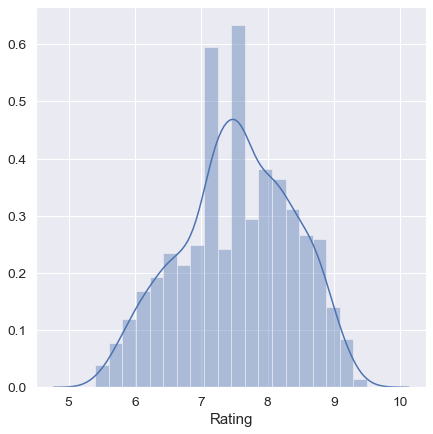

In [42]:
plt.figure(figsize=(7,7))
sns.distplot(venues_full_df['Rating']);

Next, the relationship between *Rating* and *Price Tier* is visualized in a boxplot.

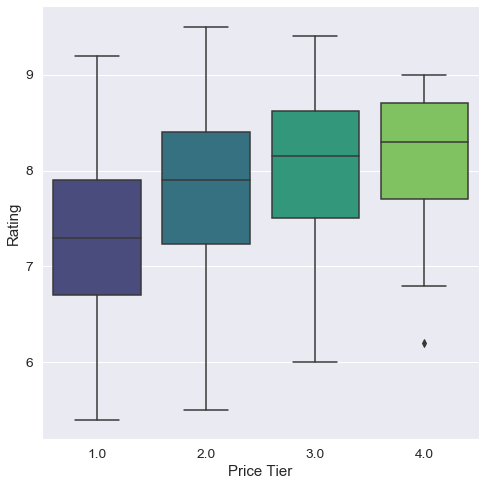

In [43]:
sns.set_style('darkgrid')
sns.catplot(x='Price Tier', y="Rating", kind='box',
            data=venues_full_df,height=7,palette='viridis');

Interestingly, only a small increase in average rating can be observed as price tier increases. 

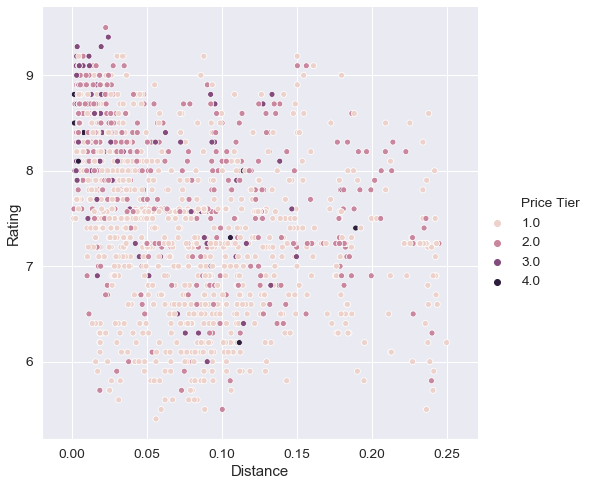

In [44]:
sns.relplot('Distance','Rating',data=venues_full_df,hue='Price Tier',height=7);

Again, a slight tendancy toward higher price tiers are observed for higher ratings. More significant is the higher concentration of highly rated restaurants closer to the city.

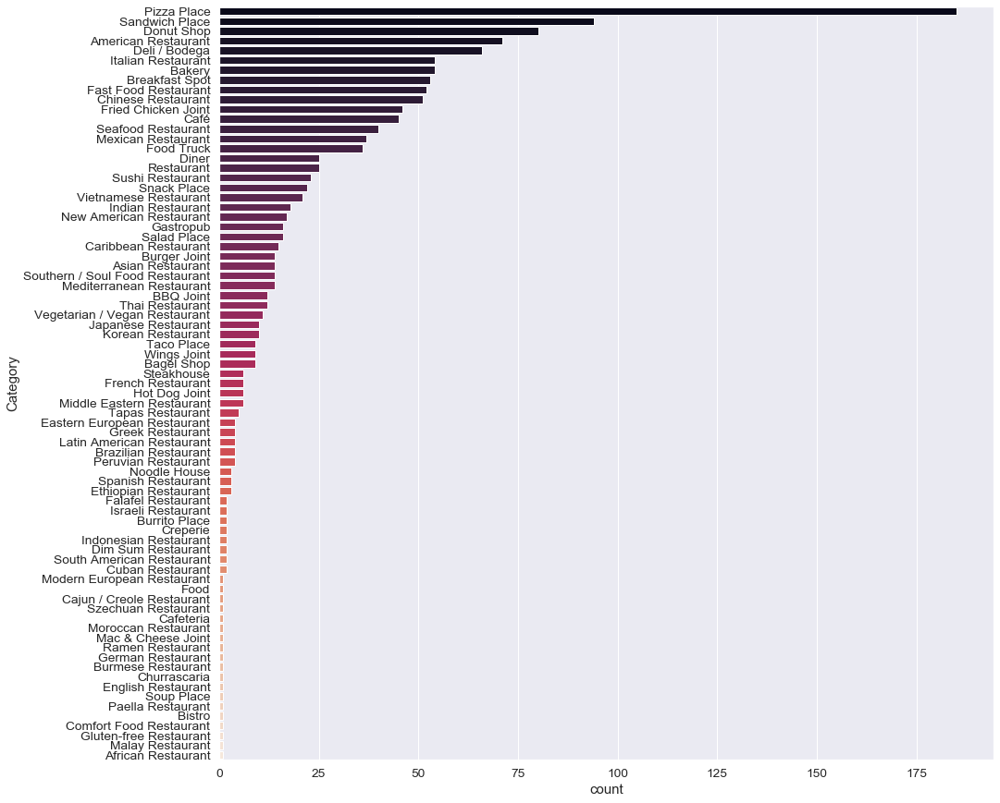

In [45]:
plt.figure(figsize=(15,15))
sns.countplot(y='Category',data=venues_full_df,palette='rocket',
              order=venues_full_df['Category'].value_counts().index);

There is heavy skewness toward the top of the plot; the majority of venues belonging to a small set of categories. Subsequntly, extracting the top five category types for the zip codes (as we have done in the labs) would not yield any insight as the probability is so highly skewed in the top categories' favor. 

Let's create some subsets of our columns for indexing purposes.

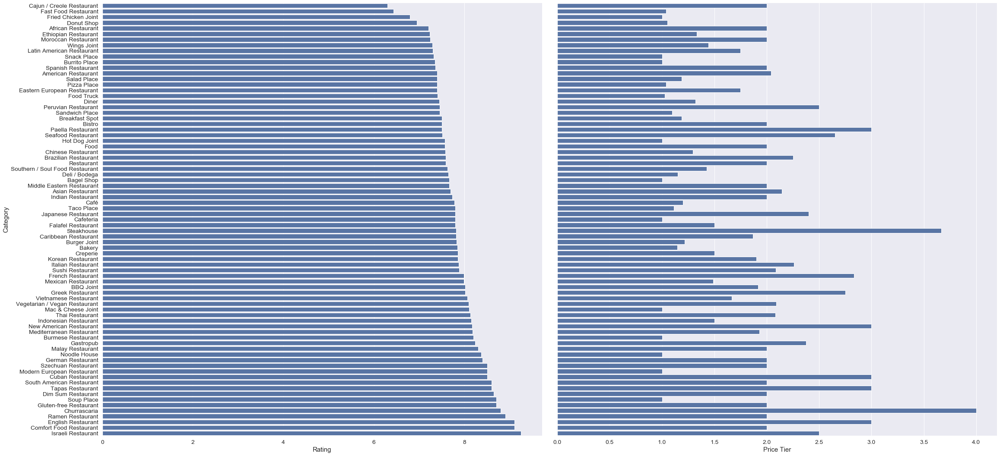

In [46]:
cate_df = venues_full_df.groupby(by='Category').mean().sort_values('Rating')
cate_df.reset_index(inplace=True)
catecount_df = pd.DataFrame(venues_full_df.groupby('Category').count()['ID']).reset_index()
catecount_df.columns = ['Category','Count']
cate_df = cate_df.merge(catecount_df,on='Category')

g = sns.PairGrid(cate_df, y_vars=["Category"], x_vars=["Rating", "Price Tier"], height=15)
g.map(sns.barplot,orient='h');

In [47]:
cols = list(venues_full_df.columns)
e_col = []
for i, col in enumerate(cols):
    e_col.append((i,col))


cats = cols[41:]
atts = cols[9:41]
top_cats = venues_full_df.groupby('Category').count().sort_values('ID',ascending=False).head(10).index.values
uncommon_cats = list(set(cats) - set(top_cats))

### 4.1 Zip Data

In [48]:
grouped_df = venues_full_df.groupby(by='Zip').mean()
grouped_df.reset_index(inplace=True)
grouped_df.head()

,Zip,Distance,Rating,Price Tier,Delivery,Alcohol,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking,African Restaurant,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bistro,Brazilian Restaurant,Breakfast Spot,Burger Joint,Burmese Restaurant,Burrito Place,Cafeteria,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Churrascaria,Comfort Food Restaurant,Creperie,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Food,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Indonesian Restaurant,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mac & Cheese Joint,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,New American Restaurant,Noodle House,Paella Restaurant,Peruvian Restaurant,Pizza Place,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint,Moroccan Restaurant
0,19102,0.003514,8.326087,2.304348,0.434783,0.478261,0.695652,0.043478,0.260870,0.130435,0.434783,0.608696,0.739130,0.173913,0.347826,0.043478,0.000000,0.043478,0.086957,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.043478,0.043478,0.0,0.000000,0.0,0.0,0.0,0.0,0.043478,0.000000,0.000000,0.000000,0.043478,0.000000,0.000000,0.043478,0.043478,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.086957,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.043478,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.043478,0.000000,0.000000,0.0,0.000000,0.043478,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.043478,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.130435,0.000000,0.0,0.000000,0.130435,0.000000,0.043478,0.000000,0.000000,0.086957,0.000000,0.0,0.0,0.000000,0.0,0.086957,0.043478,0.000000,0.043478,0.000000,0.000000,0.000000,0.000000,0.0,0.0
1,19103,0.008911,8.225455,1.945455,0.472727,0.381818,0.527273,0.163636,0.145455,0.109091,0.509091,0.618182,0.672727,0.072727,0.218182,0.000000,0.072727,0.000000,0.072727,0.018182,0.090909,0.036364,0.018182,0.000000,0.018182,0.018182,0.018182,0.000000,0.000000,0.000000,0.000000,0.0,0.018182,0.0,0.0,0.0,0.0,0.054545,0.000000,0.000000,0.000000,0.036364,0.000000,0.018182,0.000000,0.000000,0.000000,0.0,0.0,0.018182,0.000000,0.000000,0.018182,0.000000,0.000000,0.000000,0.018182,0.090909,0.000000,0.018182,0.018182,0.0,0.018182,0.000000,0.000000,0.018182,0.0,0.018182,0.000000,0.000000,0.000000,0.0,0.018182,0.000000,0.000000,0.018182,0.0,0.018182,0.127273,0.018182,0.000000,0.000000,0.018182,0.000000,0.018182,0.018182,0.0,0.000000,0.036364,0.000000,0.0,0.000000,0.018182,0.000000,0.018182,0.072727,0.036364,0.036364,0.000000,0.0,0.0,0.000000,0.0,0.018182,0.054545,0.000000,0.036364,0.018182,0.036364,0.018182,0.000000,0.0,0.0
2,19104,0.033466,7.386931,1.378947,0.315789,0.147368,0.410526,0.168421,0.094737,0.147368,0.210526,0.347368,0.242105,0.084211,0.073684,0.000000,0.031579,0.010526,0.021053,0.031579,0.010526,0.010526,0.000000,0.010526,0.021053,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.052632,0.021053,0.021053,0.000000,0.042105,0.000000,0.000000,0.031579,0.010526,0.000000,0.0,0.0,0.042105,0.010526,0.010526,0.021053,0.000000,0.000000,0.010526,

Let's add some extra columns that may give us some insight into our new grouped data. *Count* will represent the number of restaurants in the zip code while *Density Rank* will show a ranking of the count divided by the total area of the zip.

In [49]:
count = venues_full_df.groupby('Zip').count()['ID'].values
grouped_df.insert(1,'Count',count)

areas = []
for d in data['features']:
    area = [d['properties']['Shape__Area']]
    z = [d['properties']['CODE']]
    t = z+area
    areas.append(t)
area_df = pd.DataFrame(areas,columns=['Zip','Area'])
grouped_df = pd.merge(grouped_df,area_df,on='Zip')
grouped_df['Density']  = grouped_df['Count']/grouped_df['Area']
grouped_df['Density Rank'] = grouped_df['Density'].rank()
d_ranks = grouped_df['Density Rank']
grouped_df.drop(['Density','Density Rank','Area'],1,inplace=True)
grouped_df.insert(1,'Density Rank',d_ranks)

In the following map, several layers can be toggled to visualize a range of interesting variables. Test it out by toggling layers through the top right layer control button.

In [50]:
from folium import plugins
from folium.plugins import HeatMap

m3 = folium.Map([start_lat,start_long],zoom_start = 11)

cluster_markers_fg = folium.FeatureGroup(name='Restaurants clusters')
venues = plugins.MarkerCluster()
for lt, lng, label1,label2, in zip(venues_full_df['Lat'], venues_full_df['Long'], 
                                   venues_full_df['Name'],venues_full_df['Zip']):
    folium.Marker(
        location=[lt, lng],
        popup=(label1,label2),
    ).add_to(venues)
venues.add_to(cluster_markers_fg)

choropleth1 = folium.Choropleth(
    geo_data=philly_zips,
    name='Zips',
    fill_opacity=0.1,
    line_opacity=0.5,
    highlight=True,
    line_color='blue',
    show=False
).add_to(m3)

cluster_markers_fg.add_to(m3)

choropleth2 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Density',
    columns=['Zip','Density Rank'],
    highlight=True,
    line_color='blue',
    key_on='feature.properties.CODE',
).add_to(m3)

choropleth3 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Rating',
    columns=['Zip','Rating'],
    highlight=True,
    fill_color = 'YlOrRd',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False,
).add_to(m3)

choropleth4 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Price Tier',
    columns=['Zip','Price Tier'],
    highlight=True,
    fill_color = 'PuRd',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False
).add_to(m3)

choropleth5 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Delivery',
    columns=['Zip','Delivery'],
    highlight=True,
    fill_color = 'OrRd',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False
).add_to(m3)

choropleth6 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Alcohol',
    columns=['Zip','Alcohol'],
    highlight=True,
    fill_color = 'YlGn',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False
).add_to(m3)

choropleth7 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Outdoor Seating',
    columns=['Zip','Outdoor Seating'],
    highlight=True,
    fill_color = 'PuRd',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False
).add_to(m3)

choropleth8 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Distance',
    columns=['Zip','Distance'],
    highlight=True,
    fill_color = 'YlGn',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False
).add_to(m3)

choropleth9 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Dinner',
    columns=['Zip','Dinner'],
    highlight=True,
    fill_color = 'BuPu',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False
).add_to(m3)

choropleths = [choropleth1,choropleth2,choropleth3,choropleth4,choropleth5,choropleth6,choropleth7,choropleth8,choropleth9]

for choro in choropleths:
    choro.geojson.add_child(
    folium.features.GeoJsonTooltip(['CODE'],labels=False))
    for key in choro._children:
        if key.startswith('color_map'):
            del(choro._children[key])

        
fg_heat = folium.FeatureGroup(name='Heatmap',show=False)
heat_data = [[row['Lat'],row['Long']] for index, row in venues_full_df.iterrows()]
HeatMap(heat_data,radius=15,max_val=0.5).add_to(fg_heat)

fg_heat.add_to(m3)
folium.LayerControl(collapsed=True).add_to(m3)
m3

**Assumptions** 

1. Zip codes around center city and west Philly tend to have higher densities of popular restaurants
2. Zip codes around center city and south Philly tend to have more highly rated restaurants
3. Zip codes around center city tend to be more expensive
Conclusion 1-3 were basically summarized in our earlier scatterplot of distance vs rating with price tier reflected in the hue. 

*So, unsurprising revelations so far. It should also be noted though that zip code 19127 acts similar to the zip codes in center city. We may expect 19127 to be clustered together with the center city zips!*

4. Delivery appears rather randomly distributed, although a slight tendency can be seen for venues further away from the city center to offer delivery. 
5. Zip codes around center city tend to have more restaurants offering alcohol

A pairplot will give us more substance behind our assumptions:

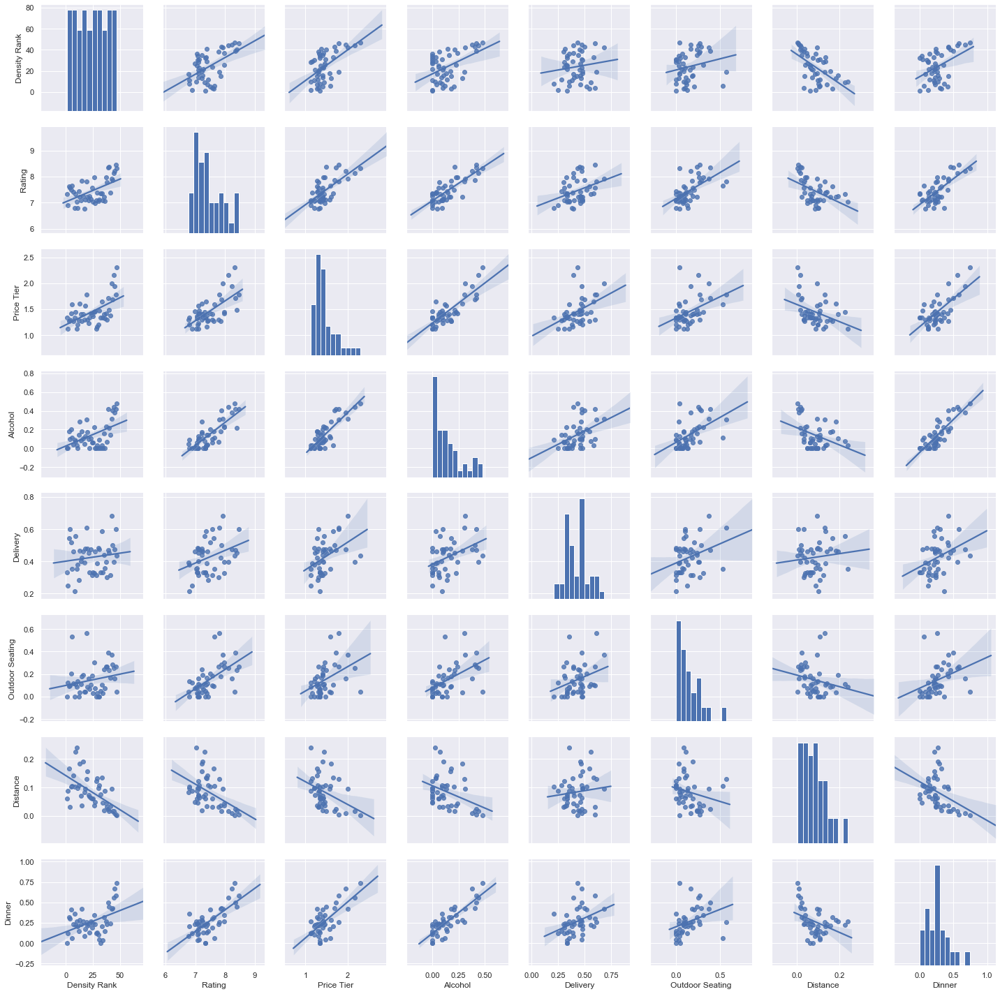

In [51]:
sns.set()
cols = ['Density Rank','Rating','Price Tier','Alcohol','Delivery','Outdoor Seating','Distance','Dinner']
sns.pairplot(grouped_df[cols], height = 2.5,kind='reg')
plt.show();

Indeed, the pairplot offers no contradiction to our assumptions. They also reveal that price and rating is positively correlated with all other variables except distance, which is negatively correlated with all other variables (except delivery).

Next, a dataframe showing the most common venues in per zip code is created. Due to the overwhelming prevelance of a few categories, we'll set the function to retrieve the ten most common categories. 

In [52]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    vals = row_categories.value_counts()
    thresh = len(row_categories)-num_top_venues
    if vals[0]<=thresh:
        row_categories_sorted = row_categories.sort_values(ascending=False)
        return row_categories_sorted.index.values[0:num_top_venues]
    else:
        print (f'**Less than {num_top_venues} venues: {row.iloc[0]}**')

grouped_cats_df = grouped_df[['Zip'] + cats]
grouped_ucats_df = grouped_df[['Zip'] + uncommon_cats]

num_top_venues = 5

indicators = ['st', 'nd', 'rd']

columns1 = ['Zip']
columns2 = ['Zip']

datasets  = [grouped_cats_df,grouped_ucats_df]

for ind in np.arange(num_top_venues):
    try:
        columns1.append('{}{} Most Common Category'.format(ind+1, indicators[ind]))
        columns2.append('{}{} Most Common U*Category'.format(ind+1, indicators[ind]))
    except:
        columns1.append('{}th Most Common Category'.format(ind+1))
        columns2.append('{}th Most Common U*Category'.format(ind+1))
        
common_df = pd.DataFrame(columns=columns1)
ucommon_df = pd.DataFrame(columns=columns2)
common_df['Zip'] = grouped_df['Zip']
ucommon_df['Zip'] = grouped_df['Zip']


for ind in np.arange(grouped_df.shape[0]):
    common_df.iloc[ind, 1:] = return_most_common_venues(grouped_cats_df.iloc[ind, :], num_top_venues)
    ucommon_df.iloc[ind, 1:] = return_most_common_venues(grouped_ucats_df.iloc[ind, :], num_top_venues)
        
common_df.dropna(axis=0,inplace=True)
ucommon_df.dropna(axis=0,inplace=True)
common_df = pd.merge(common_df,ucommon_df,on='Zip')
common_df.head()

**Less than 5 venues: 19112**
**Less than 5 venues: 19112**
**Less than 5 venues: 19121**
**Less than 5 venues: 19126**
**Less than 5 venues: 19132**
**Less than 5 venues: 19135**
**Less than 5 venues: 19137**
**Less than 5 venues: 19139**
**Less than 5 venues: 19142**
**Less than 5 venues: 19150**
**Less than 5 venues: 19154**


,Zip,1st Most Common Category,2nd Most Common Category,3rd Most Common Category,4th Most Common Category,5th Most Common Category,1st Most Common U*Category,2nd Most Common U*Category,3rd Most Common U*Category,4th Most Common U*Category,5th Most Common U*Category
0,19102,New American Restaurant,Pizza Place,Chinese Restaurant,Seafood Restaurant,Steakhouse,New American Restaurant,Seafood Restaurant,Steakhouse,Latin American Restaurant,French Restaurant
1,19103,Italian Restaurant,Deli / Bodega,Salad Place,American Restaurant,Sushi Restaurant,Salad Place,Sushi Restaurant,Seafood Restaurant,Taco Place,Thai Restaurant
2,19104,Food Truck,Sandwich Place,American Restaurant,Café,Donut Shop,Food Truck,Café,Salad Place,Snack Place,Indian Restaurant
3,19106,Italian Restaurant,New American Restaurant,Sushi Restaurant,Gastropub,Café,New American Restaurant,Gastropub,Sushi Restaurant,Café,Japanese Restaurant
4,19107,Bakery,Chinese Restaurant,Vegetarian / Vegan Restaurant,Pizza Place,Sandwich Place,Vegetarian / Vegan Restaurant,Mediterranean Restaurant,Asian Restaurant,Mexican Restaurant,Thai Restaurant


# 5. Modelling

Wow. They weren't kidding when they said that most of a data scientists job is data preparation / cleaning. Regardless, we arrive at last at the modelling stage. To kick things off, we're gonna seperate out our features from our main dataset.

In [53]:
e_cols = [(k,col) for k,col in enumerate(list(venues_full_df.columns))]
e_cols
features = venues_full_df.columns[6:]

x_df = venues_full_df[features]

### 5.1 Clustering - Kmeans

In order to assist our eventual classifiers, the venue data will be clustered using kmeans. The elbow method was used to guide the choice of n_clusters.

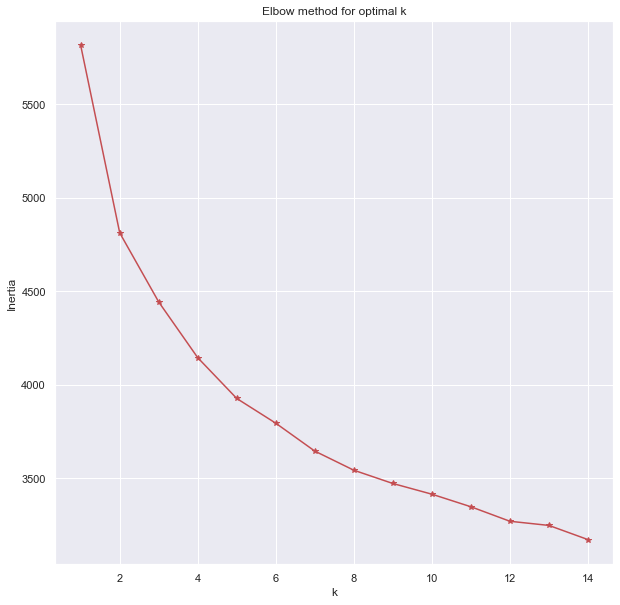

In [54]:
CLUSTER_DATA = x_df
kmax = 15
inertia = []
for k in range(1,kmax):
    kmeans = KMeans(n_clusters=k, random_state=333).fit(CLUSTER_DATA)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(10,10))
plt.plot(range(1,kmax),inertia, '*-r')
plt.xlabel('k')
plt.xticks()
plt.ylabel('Inertia')
plt.title('Elbow method for optimal k')
plt.show()

In [55]:
kclusters = 2
kmeans = KMeans(n_clusters=kclusters, random_state=333).fit(CLUSTER_DATA)
k_labels = kmeans.labels_
CLUSTER_DATA.insert(0,'Cluster Labels',k_labels)

Now we can analyze the cluster labels individually, keeping in mind the assumptions we made about our data earlier. 

In [56]:
cl_0 = x_df.loc[x_df['Cluster Labels'] == 0]
cl_0.head(20)

,Cluster Labels,Distance,Rating,Price Tier,Delivery,Alcohol,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking,African Restaurant,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bistro,Brazilian Restaurant,Breakfast Spot,Burger Joint,Burmese Restaurant,Burrito Place,Cafeteria,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Churrascaria,Comfort Food Restaurant,Creperie,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Food,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Indonesian Restaurant,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mac & Cheese Joint,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,New American Restaurant,Noodle House,Paella Restaurant,Peruvian Restaurant,Pizza Place,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint,Moroccan Restaurant
2,0,0.003215,8.8,1.0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,1,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
22,0,0.003124,7.7,1.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,1,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
30,0,0.001347,7.6,2.0,1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,1,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
36,0,0.004265,7.6,1.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,1,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
42,0,0.001188,7.5,1.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,1,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
43,0,0.002590,7.5,1.0,1,0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,1,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
44,0,0.005527,8.0,1.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [57]:
cl_1 = x_df.loc[x_df['Cluster Labels'] == 1]
cl_1.head(20)

,Cluster Labels,Distance,Rating,Price Tier,Delivery,Alcohol,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking,African Restaurant,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bistro,Brazilian Restaurant,Breakfast Spot,Burger Joint,Burmese Restaurant,Burrito Place,Cafeteria,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Churrascaria,Comfort Food Restaurant,Creperie,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Food,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Indonesian Restaurant,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mac & Cheese Joint,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,New American Restaurant,Noodle House,Paella Restaurant,Peruvian Restaurant,Pizza Place,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint,Moroccan Restaurant
0,1,0.002337,8.7,4.0,1,1,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,1.0,0,0.0,0,0,0,0,0,0,0.0
1,1,0.003525,9.3,3.0,0,1,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,1,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
3,1,0.001701,8.5,4.0,0,1,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
4,1,0.001600,8.8,4.0,0,1,1.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,1.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
5,1,0.003516,8.9,1.0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,1,0,0,0,0,0,0.0
6,1,0.003951,8.2,1.0,1,0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,1,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
7,1,0.002087,8.7,2.0,1,0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

By looking at the mean values of each cluster label, an overview can more easily be obtained. 

In [58]:
cluster_grouped = x_df.groupby('Cluster Labels').mean()
cluster_grouped

,Distance,Rating,Price Tier,Delivery,Alcohol,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking,African Restaurant,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bistro,Brazilian Restaurant,Breakfast Spot,Burger Joint,Burmese Restaurant,Burrito Place,Cafeteria,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Churrascaria,Comfort Food Restaurant,Creperie,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Food,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Indonesian Restaurant,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mac & Cheese Joint,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,New American Restaurant,Noodle House,Paella Restaurant,Peruvian Restaurant,Pizza Place,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint,Moroccan Restaurant
Cluster Labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.089434,7.092628,1.232394,0.373239,0.029343,0.372066,0.063380,0.063380,0.172535,0.089202,0.110329,0.082160,0.045775,0.009390,0.000000,0.005869,0.001174,0.016432,0.003521,0.012911,0.002347,0.007042,0.003521,0.005869,0.001174,0.001174,0.000000,0.000000,0.004695,0.004695,0.000000,0.008216,0.001174,0.003521,0.000000,0.001174,0.044601,0.007042,0.004695,0.008216,0.04108,0.001174,0.002347,0.045775,0.007042,0.000000,0.002347,0.001174,0.025822,0.001174,0.008216,0.042254,0.000000,0.000000,0.001174,0.000000,0.051643,0.000000,0.014085,0.089202,0.003521,0.000000,0.002347,0.001174,0.057512,0.001174,0.039906,0.002347,0.042254,0.000000,0.000000,0.000000,0.001174,0.004695,0.012911,0.000000,0.000000,0.021127,0.002347,0.003521,0.004695,0.000000,0.000000,0.005869,0.014085,0.002347,0.000000,0.000000,0.000000,0.001174,0.001174,0.171362,0.000000,0.012911,0.009390,0.076291,0.025822,0.019953,0.000000,0.000000,0.011737,0.002347,0.000000,0.010563,0.000000,0.007042,0.000000,0.004695,0.005869,0.005869,0.009390,0.001174
1,0.054127,8.233769,1.868762,0.502773,0.390018,0.726433,0.321627,0.203327,0.195933,0.569316,0.663586,0.648799,0.186691,0.212569,0.011091,0.072089,0.012939,0.059150,0.042514,0.083179,0.018484,0.035120,0.012939,0.031423,0.012939,0.007394,0.007394,0.007394,0.011091,0.011091,0.003697,0.011091,0.001848,0.001848,0.001848,0.000000,0.060998,0.014787,0.014787,0.003697,0.03512,0.000000,0.003697,0.025878,0.014787,0.001848,0.000000,0.000000,0.042514,0.000000,0.014787,0.027726,0.001848,0.001848,0.001848,0.003697,0.040665,0.003697,0.024030,0.007394,0.001848,0.001848,0.001848,0.001848,0.005545,0.000000,0.003697,0.007394,0.018484,0.029575,0.001848,0.001848,0.005545,0.003697,0.012939,0.003697,0.003697,0.066543,0.014787,0.012939,0.000000,0.001848,0.001848,0.016636,0.046211,0.007394,0.001848,0.031423,0.005545,0.000000,0.005545,0.072089,0.001848,0.025878,0.014787,0.053604,0.033272,0.009242,0.001848,0.003697,0.007394,0.001848,0.011091,0.025878,0.001848,0.005545,0.009242,0.014787,0.011091,0.029575,0.001848,0.000000


Looks like the *Rating* variable was a seperator for the clusters. As speculated, *Price Tier, Alcohol* exhibits positive correlation with *Rating* while *Distance* shows negative correlation with *Rating*. Similar to the labs, the most common categories were also extracted; however, this time for the cluster labels and not the neighborhoods.

In [59]:
num_top_cats = 20

common_cats = []
for i in range(0,cluster_grouped.shape[0]):
    common_cats.append(x_df.groupby('Cluster Labels').mean().iloc[i,35:].sort_values(ascending=False).index[0:20])
    
cols = ['1st','2nd','3rd'] + [f'{i}th' for i in range(4,num_top_cats+1)]
common_cats = pd.DataFrame(common_cats,columns=cols)
common_cats

,1st,2nd,3rd,4th,5th,6th,7th,8th,9th,10th,11th,12th,13th,14th,15th,16th,17th,18th,19th,20th
0,Pizza Place,Donut Shop,Sandwich Place,Fast Food Restaurant,Deli / Bodega,Breakfast Spot,American Restaurant,Chinese Restaurant,Fried Chicken Joint,Bakery,Food Truck,Café,Seafood Restaurant,Italian Restaurant,Snack Place,Diner,Mexican Restaurant,Restaurant,Indian Restaurant,Southern / Soul Food Restaurant
1,Pizza Place,Italian Restaurant,American Restaurant,Sandwich Place,Mexican Restaurant,Café,Deli / Bodega,Bakery,Seafood Restaurant,New American Restaurant,Vietnamese Restaurant,Gastropub,Chinese Restaurant,Restaurant,Breakfast Spot,Sushi Restaurant,Diner,Fried Chicken Joint,Mediterranean Restaurant,Asian Restaurant


In [60]:
m4 = folium.Map(location=[lat, long], zoom_start=10)

restaurants_markers_fg = folium.FeatureGroup(name='Restaurant markers',show=False)
venues = plugins.MarkerCluster()
for lt, lng, label1,label2, in zip(venues_full_df['Lat'], venues_full_df['Long'], 
                                   venues_full_df['Name'],venues_full_df['Zip']):
    folium.Marker(
        location=[lt, lng],
        popup=(label1,label2),
    ).add_to(venues)
venues.add_to(restaurants_markers_fg)
restaurants_markers_fg.add_to(m4)

choropleth1 = folium.Choropleth(
    geo_data=philly_zips,
    name='Zips',
    fill_opacity=0.1,
    line_opacity=0.5,
    highlight=True,
    line_color='blue',
).add_to(m4)

choropleth2 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Density',
    columns=['Zip','Density Rank'],
    highlight=True,
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False,
    fill_opacity=0.3
).add_to(m4)

choropleth3 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Rating',
    columns=['Zip','Rating'],
    highlight=True,
    fill_color = 'YlOrRd',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False,
    fill_opacity=0.3
).add_to(m4)

choropleth4 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Price Tier',
    columns=['Zip','Price Tier'],
    highlight=True,
    fill_color = 'PuRd',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False,
    fill_opacity=0.3
).add_to(m4)

choropleth5 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Delivery',
    columns=['Zip','Delivery'],
    highlight=True,
    fill_color = 'OrRd',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False,
    fill_opacity=0.3
).add_to(m4)

choropleth6 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Alcohol',
    columns=['Zip','Alcohol'],
    highlight=True,
    fill_color = 'YlGn',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False,
    fill_opacity=0.3
).add_to(m4)

choropleth7 = folium.Choropleth(
    geo_data=philly_zips,
    data = grouped_df,
    name='Outdoor Seating',
    columns=['Zip','Outdoor Seating'],
    highlight=True,
    fill_color = 'PuRd',
    line_color='blue',
    key_on='feature.properties.CODE',
    show=False,
    fill_opacity=0.3
).add_to(m4)

choropleths = [choropleth1,choropleth2,choropleth3,choropleth4,choropleth5,choropleth6,choropleth7]

for choro in choropleths:
    choro.geojson.add_child(
    folium.features.GeoJsonTooltip(['CODE'],labels=False))
    for key in choro._children:
        if key.startswith('color_map'):
            del(choro._children[key])

x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

cluster_markers_fg = folium.FeatureGroup('Cluster Markers')

markers_colors = []
marker_data = pd.merge(x_df,venues_full_df,on=x_df.index)

for lat, lon, poi, cluster in zip(marker_data['Lat'], marker_data['Long'], 
                                  marker_data['Name'], marker_data['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=1,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.2).add_to(cluster_markers_fg)
    
cluster_markers_fg.add_to(m4)        
fg_heat = folium.FeatureGroup(name='Heatmap',show=False)
heat_data = [[row['Lat'],row['Long']] for index, row in venues_full_df.iterrows()]
HeatMap(heat_data,radius=15,max_val=0.5).add_to(fg_heat)
fg_heat.add_to(m4)

folium.LayerControl(collapsed=True).add_to(m4)
m4

### 5.2 Classifiers

I don't think it makes sense to have the classifiers predict *Rating* as a continuous variable. Are humans really reliable to the first decimal on a 1 to 10 scale? I think not, I think that the difference between 8.4 and 8.5 owes to noise and randomness. Additionally, I just feel like using classifiers instead of regression, so we'll change the *Rating* variable to be ordinal (0-3), indicating Low to High ratings. 

In [61]:
a = np.linspace(x_df['Rating'].min(),x_df['Rating'].max(),6)

for index, row in x_df.iterrows():
    if row['Rating'] <= a[1]:
        x_df.at[index,'Rating'] = 0
    elif row['Rating'] <= a[3]:
        x_df.at[index,'Rating'] = 1
    elif row['Rating'] <= a[5]:
        x_df.at[index,'Rating'] = 2


x_df.head()

,Cluster Labels,Distance,Rating,Price Tier,Delivery,Alcohol,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking,African Restaurant,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bistro,Brazilian Restaurant,Breakfast Spot,Burger Joint,Burmese Restaurant,Burrito Place,Cafeteria,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Churrascaria,Comfort Food Restaurant,Creperie,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Food,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Indonesian Restaurant,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mac & Cheese Joint,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,New American Restaurant,Noodle House,Paella Restaurant,Peruvian Restaurant,Pizza Place,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint,Moroccan Restaurant
0,1,0.002337,2.0,4.0,1,1,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,1.0,0,0.0,0,0,0,0,0,0,0.0
1,1,0.003525,2.0,3.0,0,1,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,1,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
2,0,0.003215,2.0,1.0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,1,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
3,1,0.001701,2.0,4.0,0,1,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0
4,1,0.001600,2.0,4.0,0,1,1.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,1.0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0.0,0,0,0,0.0,0.0,0.0,0,0,0,0.0,0.0,0,0,0,0,0.0,0.0,0,0,0,0.0,0,0.0,0.0,0.0,0,0.0,0,0,0,0,0,0.0,0.0,0,0,0.0,0,0.0,0,0,0,0,0,0,0.0


Creating our train test split and standardizing our dataset. and importing all our machine learning packages from sklearn.  

In [62]:
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn.linear_model import RidgeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import log_loss
from sklearn.metrics import jaccard_score
from sklearn.metrics import f1_score

x_cols = list(x_df.columns)
x_cols.remove('Rating')

X = x_df[x_cols]
#X = x_df[x_cols[:35]]
#X = StandardScaler().fit_transform(X1)

#X.drop(['Cluster Labels'],1,inplace=True)
Y = x_df['Rating']
X_train,X_test,Y_train,Y_test = train_test_split(X,Y,test_size=0.2, random_state=0)

In [63]:
def clf_eval(Y_test,yhat,name):
    accuracy = round(metrics.accuracy_score(Y_test, yhat),4)
    f1 = round(f1_score(Y_test, yhat,average='weighted'),4)
    jaccard = round(jaccard_score(Y_test, yhat,average='weighted'),4)
    precision = round(metrics.precision_score(Y_test, yhat,average='weighted'),4)
    recall = round(metrics.recall_score(Y_test, yhat,average='weighted'),4) 
    eval_df = pd.DataFrame([[accuracy, f1, jaccard, precision, recall]],
                           columns=['Accuracy','F1 Score','Jaccard Score','Precision','Recall'],
                           index=[name])
    #return accuracy, f1, jaccard, precision, recall
    return eval_df

**5.2.1 Support Vector Machine**

In [64]:
kernels  = ['linear', 'poly', 'rbf', 'sigmoid']
eval_df = pd.DataFrame()

for k in kernels:
    svm_clf = svm.SVC(kernel=k,gamma='auto',class_weight='balanced')
    svm_clf.fit(X_train,Y_train)
    svm_yhat = svm_clf.predict(X_test)
    
    row = clf_eval(Y_test,svm_yhat,k)
    eval_df = pd.concat([eval_df,row])


best_kernel = eval_df[eval_df['F1 Score'] == eval_df['F1 Score'].max()].index.values[0]    
print ('\nBest F1: {} {}'.format(best_kernel,
                                 eval_df['F1 Score'].max()))
eval_df


Best F1: rbf 0.7155


,Accuracy,F1 Score,Jaccard Score,Precision,Recall
linear,0.6631,0.6803,0.5280,0.7368,0.6631
poly,0.5269,0.3636,0.2776,0.2776,0.5269
rbf,0.7025,0.7155,0.5674,0.7512,0.7025
sigmoid,0.6774,0.6962,0.5461,0.7595,0.6774


In [65]:
svm_clf = svm.SVC(kernel=best_kernel,gamma='auto',class_weight='balanced')
svm_clf.fit(X_train,Y_train)
svm_yhat = svm_clf.predict(X_test)
svm_eval = clf_eval(Y_test,svm_yhat,'SVM')

print (svm_clf)
svm_eval

SVC(C=1.0, cache_size=200, class_weight='balanced', coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)


,Accuracy,F1 Score,Jaccard Score,Precision,Recall
SVM,0.7025,0.7155,0.5674,0.7512,0.7025


**5.2.2 Decision Tree**

In [66]:
max_depth = 20
eval_df = pd.DataFrame()

for k in range(1,max_depth):
    dt_clf = DecisionTreeClassifier(criterion='entropy', max_depth = k,class_weight='balanced')
    dt_clf.fit(X_train,Y_train)
    dt_yhat = dt_clf.predict(X_test)
    
    row = clf_eval(Y_test,dt_yhat,k)
    eval_df = pd.concat([eval_df,row])

best_depth = eval_df[eval_df['F1 Score'] == eval_df['F1 Score'].max()].index.values[0]    
print ('\nBest F1: {} {}'.format(eval_df[eval_df['F1 Score'] == eval_df['F1 Score'].max()].index.values[0],
                                 eval_df['F1 Score'].max()))
eval_df   


Best F1: 3 0.7492


,Accuracy,F1 Score,Jaccard Score,Precision,Recall
1,0.4086,0.3397,0.2813,0.3233,0.4086
2,0.7527,0.7416,0.6094,0.7338,0.7527
3,0.7491,0.7492,0.6104,0.7503,0.7491
4,0.7204,0.7302,0.5827,0.7620,0.7204
5,0.7097,0.7208,0.5715,0.7451,0.7097
6,0.7133,0.7235,0.5756,0.7469,0.7133
7,0.7025,0.7130,0.5714,0.7268,0.7025
8,0.6237,0.6560,0.5027,0.7121,0.6237
9,0.6559,0.6693,0.5145,0.6940,0.6559
10,0.6918,0.7020,0.5539,0.7174,0.6918


In [67]:
dt_clf = DecisionTreeClassifier(criterion='entropy', max_depth = best_depth,class_weight='balanced').fit(X_train,Y_train)
dt_yhat = dt_clf.predict(X_test)
dt_eval = clf_eval(Y_test,dt_yhat,'DTree')

print(dt_clf)
dt_eval

DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=3, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')


,Accuracy,F1 Score,Jaccard Score,Precision,Recall
DTree,0.7491,0.7492,0.6104,0.7503,0.7491


**5.2.3 Logistic Regression**

In [68]:
log_clf = LogisticRegression(C=0.01,solver='liblinear',multi_class='ovr',class_weight='balanced').fit(X_train,Y_train)
log_yhat = log_clf.predict(X_test)
log_eval = clf_eval(Y_test,log_yhat,'Log Reg')

print(log_clf)

log_eval

LogisticRegression(C=0.01, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=100, multi_class='ovr', n_jobs=None, penalty='l2',
                   random_state=None, solver='liblinear', tol=0.0001, verbose=0,
                   warm_start=False)


,Accuracy,F1 Score,Jaccard Score,Precision,Recall
Log Reg,0.7706,0.7449,0.6196,0.7512,0.7706


**5.2.4 Ridge Regression**

In [69]:
ridge_clf = RidgeClassifier(class_weight='balanced').fit(X_train, Y_train)
ridge_yhat = ridge_clf.predict(X_test)
ridge_eval = clf_eval(Y_test,ridge_yhat,'Ridge Reg')

print(ridge_clf)
ridge_eval

RidgeClassifier(alpha=1.0, class_weight='balanced', copy_X=True,
                fit_intercept=True, max_iter=None, normalize=False,
                random_state=None, solver='auto', tol=0.001)


,Accuracy,F1 Score,Jaccard Score,Precision,Recall
Ridge Reg,0.6667,0.6856,0.5339,0.7376,0.6667


In [70]:
clf_eval_df = pd.concat([svm_eval,dt_eval,log_eval,ridge_eval])
clf_eval_df

,Accuracy,F1 Score,Jaccard Score,Precision,Recall
SVM,0.7025,0.7155,0.5674,0.7512,0.7025
DTree,0.7491,0.7492,0.6104,0.7503,0.7491
Log Reg,0.7706,0.7449,0.6196,0.7512,0.7706
Ridge Reg,0.6667,0.6856,0.5339,0.7376,0.6667


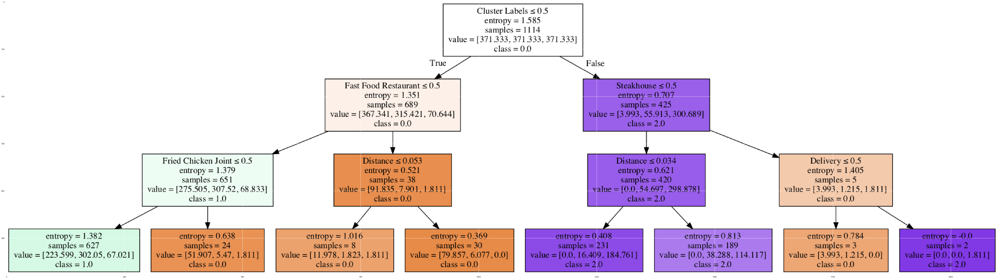

In [71]:
from sklearn.externals.six import StringIO
import pydotplus
import matplotlib.image as mpimg
from sklearn import tree
my_data = x_df
%matplotlib inline 
dot_data = StringIO()
filename = "drugtree.png"
featureNames = list(X.columns)
targetNames = list(map(str,np.sort(my_data["Rating"].unique())))
out=tree.export_graphviz(dt_clf,feature_names=featureNames, out_file=dot_data, class_names=targetNames, filled=True,  special_characters=True,rotate=False)  
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png(filename)
img = mpimg.imread(filename)
plt.figure(figsize=(100, 200))
plt.imshow(img,interpolation='nearest');

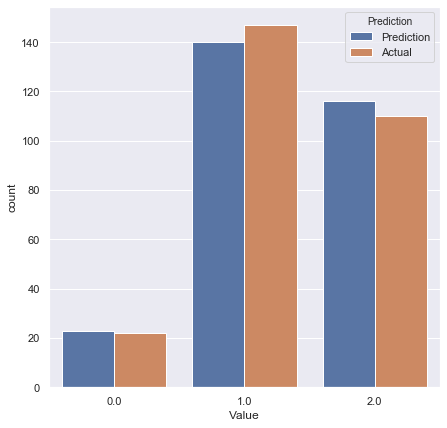

In [72]:
preds = pd.DataFrame(dt_yhat,columns=['Value'])
preds['Prediction'] = 'Prediction'
act = pd.DataFrame(np.array(Y_test),columns=['Value'])
preds_v_act = pd.concat([preds,act],axis=0,sort=False)
preds_v_act.fillna('Actual',inplace=True)
#preds_v_act
plt.figure(figsize=(7,7))
sns.countplot(data=preds_v_act,hue='Prediction',x='Value',palette='deep');

In [73]:
coefs_df = pd.DataFrame()

for coefs in log_clf.coef_:
    tempi = pd.DataFrame([coefs])
    coefs_df=pd.concat([coefs_df,tempi],sort=False)
    
coefs_df.columns=X.columns
coefs_df

,Cluster Labels,Distance,Price Tier,Delivery,Alcohol,Credit Cards,Outdoor Seating,Wi-Fi,Breakfast,Brunch,Lunch,Dinner,Reservations,Happy Hour,Bar Service,Dessert,Private Room,Restroom,Live Music,BYO,Music,Wheelchair Accessible,Take-out,Street Parking,Bar Snacks,Tasting Menu,Private Lot,Coat Check,ATM,TVs,Parking,Public Lot,Table Service,Jukebox,Valet Parking,African Restaurant,American Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bistro,Brazilian Restaurant,Breakfast Spot,Burger Joint,Burmese Restaurant,Burrito Place,Cafeteria,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Churrascaria,Comfort Food Restaurant,Creperie,Cuban Restaurant,Deli / Bodega,Dim Sum Restaurant,Diner,Donut Shop,Eastern European Restaurant,English Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Food,Food Truck,French Restaurant,Fried Chicken Joint,Gastropub,German Restaurant,Gluten-free Restaurant,Greek Restaurant,Hot Dog Joint,Indian Restaurant,Indonesian Restaurant,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Latin American Restaurant,Mac & Cheese Joint,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,New American Restaurant,Noodle House,Paella Restaurant,Peruvian Restaurant,Pizza Place,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Seafood Restaurant,Snack Place,Soup Place,South American Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Wings Joint,Moroccan Restaurant
0,-0.553965,-0.007808,-0.495018,-0.031413,-0.143049,0.218098,-0.175780,-0.051850,0.153635,-0.195474,-0.049853,-0.134795,-0.087871,-0.072062,-0.003137,-0.017025,-0.006184,-0.053054,-0.027262,-0.061380,-0.012321,-0.035341,-0.012762,-0.027719,-0.006045,-0.004989,-0.001895,-0.002315,-0.014504,-0.009955,-0.001618,-0.021445,-0.003837,-0.004084,0.0,0.0,0.110735,-0.023823,-0.016355,-0.000226,-0.086462,-0.001658,-0.007051,0.000092,-0.024585,-0.001723,-0.005923,-0.003803,-0.007332,-0.002053,-0.027953,-0.078540,0.0,0.0,-0.004750,-0.000702,-0.123081,-0.002340,-0.043875,0.091528,-0.008777,-0.000568,-0.006495,-0.004644,0.432274,-0.002768,-0.029168,-0.004829,0.233607,-0.013480,0.0,0.0,-0.001679,0.015314,-0.027484,-0.001423,-0.002132,-0.060775,-0.012046,-0.015551,-0.010185,0.0,0.0,-0.017081,-0.055922,-0.007384,-0.001912,-0.008772,-0.005716,-0.001580,-0.005287,-0.054136,-0.001094,-0.030069,-0.037237,-0.114202,-0.014148,-0.006968,-0.002652,-0.002271,-0.001314,-0.005771,0.035219,-0.030385,-0.000814,0.013034,-0.001895,-0.017263,-0.014910,-0.029027,0.015013,0.0
0,-0.560934,0.069252,-0.044956,-0.013664,-0.119708,-0.064144,-0.110396,-0.068735,-0.034556,-0.050083,-0.163323,-0.153856,-0.026656,-0.082135,-0.009639,-0.030430,0.000323,-0.006293,-0.005193,-0.054823,-0.004725,0.004387,-0.009855,-0.016907,-0.008697,-0.007678,-0.007016,-0.008108,0.003564,0.002934,-0.002982,0.018263,0.000471,0.011680,0.0,0.0,0.023679,-0.010208,-0.003332,-0.016784,-0.009488,0.003208,0.007843,0.014579,-0.000555,-0.002668,-0.001567,0.002959,-0.014593,0.003127,0.008035,0.036464,0.0,0.0,-0.000425,-0.002605,0.054223,-0.004860,0.021871,0.017012,0.005714,-0.002113,0.010807,0.000397,-0.075132,0.003055,0.029796,0.001621,-0.033397,-0.015995,0.0,0.0,-0.005281,-0.013185,0.002088,-0.002825,-0.005379,-0.006182,0.003971,-0.001890,0.004126,0.0,0.0,-0.021714,-0.008691,-0.007625,-0.002839,-0.016606,-0.009264,0.003017,0.001351,0.098227,-0.002458,0.015863,0.040390,0.041578,0.025691,0.005541,-0.003696,-0.005546,0.000527,0.010166,0.001374,-0.001832,-0.002055,-0.003369,0.000499,-0.022262,-0.010063,-0.018387,0.003483,0.0
0,0.802235,-0.119212,-0.141613,-0.086317,0.188150,-0.132749,0.151514,0.079176,-0.078907,0.064288,0.143932,0.179820,0.044807,0.125664,0.014977,0.043520,0.002127,0.019164,0.011771,0.081128,0.009916,-0.000195,0.014898,0.028809,0.013412